In [1]:
import numpy as np
import pandas as pd
import seaborn as sns
%matplotlib inline
import matplotlib.pyplot as plt
plt.style.use('seaborn-whitegrid')

import pyMechkar as mechkar
import pyTable1 as tbl1
import datetime as dt

from scipy.stats import kurtosis,skew,normaltest,anderson,spearmanr
import missingno as msno

from sklearn.cluster import KMeans
from sklearn import neighbors
from sklearn.neighbors import KNeighborsRegressor
from sklearn.metrics import mean_squared_error 
from sklearn.feature_selection import SelectFromModel

from sklearn.linear_model import Lasso,LinearRegression
from sklearn.ensemble import RandomForestRegressor,AdaBoostRegressor,GradientBoostingRegressor
from sklearn.svm import LinearSVR
from sklearn import preprocessing
from sklearn.svm import SVR

import math
from xgboost import XGBRegressor, plot_importance
from math import sqrt

In [2]:
desired_width = 1000
pd.set_option('display.width', desired_width)
pd.set_option('display.max_columns',200)
np.set_printoptions(linewidth = desired_width)
#pd.set_option('display.height', 500)
pd.set_option('display.max_rows', 500)

In [3]:
from IPython.core.display import display, HTML
display(HTML("<style>.container { width:95% !important; }</style>"))

In [4]:
#A function to calculate Root Mean Squared Logarithmic Error (RMSLE)
def rmsle(y, y_pred):
    assert len(y) == len(y_pred)
    terms_to_sum = [(math.log(y_pred[i] + 1) - math.log(y[i] + 1)) ** 2.0 for i,pred in enumerate(y_pred)]
    return (sum(terms_to_sum) * (1.0/len(y))) ** 0.5


def rmsle1(real, predicted):
    sum=0.0
    for x in range(len(predicted)):
        p = np.log(predicted[x]+1)
        r = np.log(real[x]+1)
        sum = sum + (p - r)**2
    return (sum/len(predicted))**0.5

In [5]:
def make_one_hot(data,col_name):
    new_col_names = list(data[col_name].unique())
    ncat = len(new_col_names)
    for i in range(0,ncat):
        data[new_col_names[i]] = None
        data.loc[(data[col_name] == new_col_names[i]),new_col_names[i]] = 1
        data.loc[(data[col_name] != new_col_names[i]),new_col_names[i]] = 0 

In [6]:
def zscore_outliers(x, cutoff=3.0, return_thresholds=False):
    """
    Return a boolean mask of outliers for a series
    using standard deviation, works column-wise.
    param nstd:
        Set number of standard deviations from the mean
        to consider an outlier
    :type nstd: ``float``
    param return_thresholds:
        True returns the lower and upper bounds, good for plotting.
        False returns the masked array 
    :type return_thresholds: ``bool``
    """
    dmean = x.mean()
    dsd = x.std()
    rng = dsd * cutoff
    lower = dmean - rng
    upper = dmean + rng
    if return_thresholds:
        return lower, upper
    else:
        return [True if z < lower or z > upper else False for z in x]


def iqr_outliers(x, k=1.5, return_thresholds=False):
    """
    Return a boolean mask of outliers for a series
    using interquartile range, works column-wise.
    param k:
        some cutoff to multiply by the iqr
    :type k: ``float``
    param return_thresholds:
        True returns the lower and upper bounds, good for plotting.
        False returns the masked array 
    :type return_thresholds: ``bool``
    """
    # calculate interquartile range
    q25 = np.percentile(x, 25)
    q75 = np.percentile(x, 75)
    iqr = q75 - q25
    # calculate the outlier cutoff
    cut_off = iqr * k
    lower, upper = q25 - cut_off, q75 + cut_off
    if return_thresholds:
        return lower, upper
    else: # identify outliers
        return [True if z < lower or z > upper else False for z in x]

In [7]:
def Automatic_Normality_Test(Ordinal_Fields, df, k):
    for C in Ordinal_Fields:
        n = 0
        # normality test
        #print(C)
        stat, p = normaltest(df[C])
        #print('Normaltest Statistics=%.3f, p=%.3f' % (stat, p))
        result = anderson(df[C])
        #print('Anderson Statistic: %.3f' % result.statistic)
        # interpret
        alpha = 0.05
        for i in range(len(result.critical_values)):
            sl, cv = result.significance_level[i], result.critical_values[i]
            if result.statistic < result.critical_values[i]:
                #print('%.3f: %.3f, data looks normal (fail to reject H0)' % (sl, cv))
                n = n + 1
            else:
                #print('%.3f: %.3f, data does not look normal (reject H0)' % (sl, cv))
                n = n - 1

        if p > alpha:
            #print('Sample looks Gaussian (fail to reject H0)')
            n = n + 1
        else:
            #print('Sample does not look Gaussian (reject H0)')
            n = n - 1


        if n <= 0:
            print(C," ",n,'/6 tests came negative, data does not look normal')
            #print("IQR number of outliers for ", C , " is: " , np.sum(iqr_outliers(df[C],k=k,return_thresholds=False)))
            '''out = np.sum(iqr_outliers(df[C],k=k,return_thresholds=False))
            if out > 0:
                iqr=iqr_outliers(df[C],k=k,return_thresholds=False)
                plt.figure(C)
                sns.scatterplot(x=df[C],y=df['air_store_id'],hue=iqr)'''
            #print("   ")
        else:
            print(C," ",n,'/6 tests came positive, data looks normal')
            #print("Zscore number of outliers for ", C , " is: " , np.sum(zscore_outliers(df[C], cutoff=k, return_thresholds=False)))
            '''out = np.sum(zscore_outliers(df[C], cutoff=k, return_thresholds=False))
            if out > 0:
                z=zscore_outliers(df[C], cutoff=k, return_thresholds=False)
                plt.figure(C)
                sns.scatterplot(x=df[C],y=df['air_store_id'],hue=z)'''
            #print("   ")

In [8]:
def plot_outliers(Ordinal_Fields, df, k):
    n=0
    for C in Ordinal_Fields:
        iqr=iqr_outliers(df[C],k=k[n],return_thresholds=False)
        f, ax = plt.subplots(figsize=(30,5), ncols=2, nrows=1)
        sns.scatterplot(x=df[C],y=df['air_store_id'],hue=iqr,ax=ax[0])
        sns.distplot(df[C],ax=ax[1])
        n = n + 1

In [38]:
def hdbscan(X,mcs,min_s):
    from sklearn.preprocessing import StandardScaler
    from joblib import Memory
    import hdbscan
    # scale data first
    X = StandardScaler().fit_transform(X.values)
    
    db = hdbscan.HDBSCAN(algorithm='best', memory=Memory(cachedir='D:\\EndProject\\hdbscanCache'),metric='euclidean', min_cluster_size=mcs, min_samples=min_s).fit(X)
    labels = db.labels_

    plt.figure(figsize=(10,10))

    unique_labels = set(labels)
    colors = ['blue', 'red']

    for color,label in zip(colors, unique_labels):
        sample_mask = [True if l == label else False for l in labels]
        plt.plot(X[:,0][sample_mask], X[:, 1][sample_mask], 'o', color=color);
    plt.xlabel('x');
    plt.ylabel('y');

    return(db)

In [10]:
def dbscan_mvoutliers(X,eps,min_s):
    from sklearn.cluster import DBSCAN
    from sklearn.preprocessing import StandardScaler
    # scale data first
    X = StandardScaler().fit_transform(X.values)

    db = DBSCAN(eps=eps, min_samples=min_s).fit(X)
    labels = db.labels_

    plt.figure(figsize=(10,10))

    unique_labels = set(labels)
    colors = ['blue', 'red']

    for color,label in zip(colors, unique_labels):
        sample_mask = [True if l == label else False for l in labels]
        plt.plot(X[:,0][sample_mask], X[:, 1][sample_mask], 'o', color=color);
    plt.xlabel('x');
    plt.ylabel('y');

    return(db)

# Data Collection

## Read FlatFile csv

In [11]:
FF = pd.read_csv("D:\\EndProject\\FlatFile.csv",header=0)
FF['visit_date'] =  pd.to_datetime(FF['visit_date'], format = '%Y-%m-%d')
#FF['air_store_id'] = FF['air_store_id'].apply(lambda id: "a" + id)
#FF[['st_lat','st_long']] = round(FF[['st_lat','st_long']],-1)
#FF.head()

In [11]:
FF.head()

,air_store_id,air_genre_name,air_area_name,latitude,longitude,visit_date,visitors,reservations,daily_reservations,dow,holiday_flg,station_id,st_lat,st_long,st_vincenty,st_great_circle,avg_temperature,high_temperature,low_temperature,precipitation,hours_sunlight,solar_radiation,deepest_snowfall,total_snowfall,avg_wind_speed,avg_vapor_pressure,avg_local_pressure,avg_humidity,avg_sea_pressure,cloud_cover
0,air_04341b588bde96cd,Izakaya,Tokyo-to Nerima-ku Toyotamakita,35.735623,139.651658,2016-01-01,10,NaN,510,Friday,1,tokyo__nerima-kana__nerima,35.738333,139.591667,5.435240,5.424557,6.9,11.8,2.1,0.0,9.1,NaN,NaN,NaN,1.8,NaN,NaN,NaN,NaN,NaN
1,air_05c325d315cc17f5,Izakaya,Fukuoka-ken Fukuoka-shi Daimyo,33.589216,130.392813,2016-01-01,29,NaN,510,Friday,1,fukuoka__fukuoka-kana__fukuoka,33.581667,130.375000,1.853535,1.851854,7.3,12.6,3.1,NaN,6.6,10.35,NaN,NaN,2.1,7.6,1029.2,76.0,1031.1,4.3
2,air_08ba8cd01b3ba010,Izakaya,Miyagi-ken Sendai-shi Kamisugi,38.269076,140.870403,2016-01-01,11,NaN,510,Friday,1,miyagi__sendai-kana__sendai,38.261667,140.896667,2.441192,2.437165,2.4,6.1,-1.5,0.0,3.7,5.71,NaN,NaN,2.8,4.6,1019.1,64.0,1024.7,4.0
3,air_09a845d5b5944b01,Izakaya,Fukuoka-ken Kurume-shi Jonanmachi,33.319286,130.508374,2016-01-01,56,NaN,510,Friday,1,fukuoka__kurume-kana__kurume,33.303333,130.493333,2.256617,2.258974,5.9,11.1,1.9,0.0,7.3,NaN,NaN,NaN,1.2,NaN,NaN,NaN,NaN,NaN
4,air_1f7f8fa557bc0d55,Bar/Cocktail,Osaka-fu Neyagawa-shi Honmachi,34.766093,135.628100,2016-01-01,6,NaN,510,Friday,1,Osaka__hirakata-kana__hirakata,34.808333,135.671667,6.152897,6.157249,5.5,11.9,1.0,0.0,6.0,NaN,NaN,NaN,0.8,NaN,NaN,NaN,NaN,NaN


In [12]:
# reading two csv files.
# AllWeatherData - all the weather data (tmp, rain, wind, etc'..) from all the stations across all the dates
# WeatherStations - information on each weather station (latitude, longitude, altitude, name, etc'..)
AllWeatherData = pd.read_csv("D:\\EndProject\\AllWeatherData.csv",header=0)
WeatherStations = pd.read_csv("D:\\EndProject\\weather_stations.csv",header=0)

# merging both dataframes together
weather = pd.merge(WeatherStations, AllWeatherData,  how='right', left_on='id', right_on = 'station_id')

# converting the date column to date type.
weather['calendar_date'] =  pd.to_datetime(weather['calendar_date'], format = '%Y-%m-%d')

# clustering the data.
kmeans = KMeans(n_clusters=10, random_state=0).fit(weather[['longitude','latitude']])
weather['location'] = kmeans.predict(weather[['longitude','latitude']])

# grouping all the weather data by the keys ('calendar_date','latitude','longitude') using the mean function.
W = weather.groupby([weather['calendar_date'],weather['location']])[['avg_temperature','high_temperature','low_temperature','precipitation','hours_sunlight','solar_radiation','deepest_snowfall','total_snowfall','avg_wind_speed','avg_vapor_pressure','avg_local_pressure','avg_humidity','avg_sea_pressure','cloud_cover']].mean().sort_values('calendar_date')

# merge the two dataframes.
weather = pd.merge(weather[['id','prefecture','first_name','second_name','latitude','longitude','location','altitude','date_terminated','station_id','calendar_date']], W,  how='left', left_on=['calendar_date','location'],right_on=['calendar_date','location'])

# merge the two dataframes.
FF = pd.merge(FF[['air_store_id','air_genre_name','air_area_name','latitude','longitude','visit_date','visitors','reservations','daily_reservations','dow','holiday_flg','station_id','st_lat','st_long','st_vincenty']], weather[['location','avg_temperature','high_temperature','low_temperature','precipitation','hours_sunlight','solar_radiation','deepest_snowfall','total_snowfall','avg_wind_speed','avg_vapor_pressure','avg_local_pressure','avg_humidity','avg_sea_pressure','cloud_cover']],  how='left', left_on=['visit_date','st_lat','st_long'],right_on=[weather['calendar_date'],weather['latitude'],weather['longitude']])


In [13]:
weather.columns

Index(['id', 'prefecture', 'first_name', 'second_name', 'latitude', 'longitude', 'location', 'altitude', 'date_terminated', 'station_id', 'calendar_date', 'avg_temperature', 'high_temperature', 'low_temperature', 'precipitation', 'hours_sunlight', 'solar_radiation', 'deepest_snowfall', 'total_snowfall', 'avg_wind_speed', 'avg_vapor_pressure', 'avg_local_pressure', 'avg_humidity', 'avg_sea_pressure', 'cloud_cover'], dtype='object')

In [14]:
FF.isnull().sum()

air_store_id               0
air_genre_name             0
air_area_name              0
latitude                   0
longitude                  0
visit_date                 0
visitors                   0
reservations          224044
daily_reservations         0
dow                        0
holiday_flg                0
station_id                 0
st_lat                     0
st_long                    0
st_vincenty                0
location                   0
avg_temperature            0
high_temperature           0
low_temperature            0
precipitation              0
hours_sunlight             0
solar_radiation            0
deepest_snowfall           0
total_snowfall             0
avg_wind_speed             0
avg_vapor_pressure         0
avg_local_pressure         0
avg_humidity               0
avg_sea_pressure           0
cloud_cover                0
dtype: int64

In [15]:
FF.min()

air_store_id                    air_00a91d42b08b08d9
air_genre_name                                 Asian
air_area_name         Fukuoka-ken Fukuoka-shi Daimyo
latitude                                      33.212
longitude                                    130.196
visit_date                       2016-01-01 00:00:00
visitors                                           1
reservations                                       1
daily_reservations                               510
dow                                           Friday
holiday_flg                                        0
station_id            Osaka__hirakata-kana__hirakata
st_lat                                        33.225
st_long                                       130.19
st_vincenty                                 0.416011
location                                           0
avg_temperature                             -13.9833
high_temperature                            -7.91364
low_temperature                             -2

In [16]:
FF.to_csv("D:\\EndProject\\ProjectFlatFile.csv", encoding='utf-8', index=False)

# _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _

# Exploratory Data Analysis

In [67]:
## use describe() to get the descriptive statistics
# this is data exploration.  if the mean and 50% are similar it might be a normal variable 
FF.describe()

,latitude,longitude,visitors,reservations,daily_reservations,st_lat,st_long,st_vincenty,avg_temperature,high_temperature,low_temperature,precipitation,hours_sunlight,solar_radiation,deepest_snowfall,total_snowfall,avg_wind_speed,avg_vapor_pressure,avg_local_pressure,avg_humidity,avg_sea_pressure,cloud_cover,month,week,day
count,252108.000000,252108.000000,252108.000000,28064.000000,252108.000000,252108.000000,252108.000000,252108.000000,252108.000000,252108.000000,252108.000000,252108.000000,252108.000000,252108.000000,252108.000000,252108.000000,252108.000000,252108.000000,252108.000000,252108.000000,252108.000000,252108.000000,252108.000000,252108.000000,252108.000000
mean,35.613121,137.357865,20.973761,13.751283,24727.685353,35.614647,137.357938,3.821379,12.437472,17.191895,8.220057,4.838338,4.824140,12.821108,15.157872,1.544009,2.286655,13.095185,1000.569814,71.458947,1014.954251,6.906527,6.208200,25.001043,15.591830
std,2.044473,3.671577,16.757007,17.284799,20463.131251,2.044327,3.671401,2.197806,8.881032,9.013641,9.282349,9.044222,3.082495,6.257907,26.620637,3.782420,0.748341,8.340493,11.745478,11.147393,7.133973,2.441930,3.680263,16.008416,8.670745
min,33.211967,130.195555,1.000000,1.000000,510.000000,33.225000,130.190000,0.416011,-13.983333,-7.913636,-20.627273,0.000000,0.000000,0.894000,0.000000,0.000000,1.035878,1.637500,940.571429,42.050000,986.418750,0.000000,1.000000,1.000000,1.000000
25%,34.692337,135.341564,9.000000,5.000000,12017.000000,34.681667,135.335000,1.939005,4.829545,9.530000,0.351515,0.232143,2.195082,8.061250,0.000000,0.000000,1.755085,5.917647,995.229412,62.705882,1010.118750,4.977778,3.000000,10.000000,8.000000
50%,35.658068,139.670038,17.000000,10.000000,18713.000000,35.691667,139.620000,3.573166,10.907576,16.370455,6.033000,1.634503,4.883333,11.890000,0.000000,0.000000,2.097000,10.033333,1001.300000,71.294118,1015.390476,7.309091,7.000000,26.000000,16.000000
75%,35.694003,139.751599,29.000000,18.000000,29228.000000,35.691667,139.750000,5.319959,21.110606,25.033000,17.677273,5.022876,7.025410,17.472000,17.333333,0.809524,2.669167,20.840000,1007.929412,80.190476,1019.957143,9.120000,10.000000,39.000000,23.000000
max,44.020632,144.273398,877.000000,1633.000000,167953.000000,44.016667,144.278333,12.217263,29.012605,34.959167,25.179832,105.543210,13.279000,30.410000,103.735294,35.473684,7.130769,31.658333,1031.300000,98.125000,1035.550000,10.000000,12.000000,53.000000,31.000000


In [68]:
FF.dtypes

air_store_id                  object
air_genre_name                object
air_area_name                 object
latitude                     float64
longitude                    float64
visit_date            datetime64[ns]
visitors                       int64
reservations                 float64
daily_reservations             int64
dow                           object
holiday_flg                 category
station_id                    object
st_lat                       float64
st_long                      float64
st_vincenty                  float64
avg_temperature              float64
high_temperature             float64
low_temperature              float64
precipitation                float64
hours_sunlight               float64
solar_radiation              float64
deepest_snowfall             float64
total_snowfall               float64
avg_wind_speed               float64
avg_vapor_pressure           float64
avg_local_pressure           float64
avg_humidity                 float64
a

In [23]:
tbl1 = mechkar.pyMechkar().Table1(data=FF)

Factorizing... please wait
[******************************
['The variable air_store_id is not well defined. This data type is not allowed in Table1... avoided', 'The variable air_genre_name is not well defined. This data type is not allowed in Table1... avoided', 'The variable air_area_name is not well defined. This data type is not allowed in Table1... avoided', 'The variable visit_date is a date. Dates are not allowed in Table1... avoided', 'The variable dow is not well defined. This data type is not allowed in Table1... avoided', 'The variable station_id is not well defined. This data type is not allowed in Table1... avoided', "The variable location doesn't exists in the dataset... avoiding"]
------ Finished in 6.886999845504761econds -----


In [24]:
pd.set_option('display.max_rows',100)
tbl1

,Del,Variables,Categories,n,Population
0,0,Individuals,n,1,252108
1,0,latitude,Mean (SD),1,35.60 ( 2.00)
2,0,latitude,Median (IQR),2,35.70 ( 34.70- 35.70)
3,1,latitude,Missing (%),3,--
4,0,longitude,Mean (SD),1,137.40 ( 3.70)
5,0,longitude,Median (IQR),2,139.70 ( 135.30- 139.80)
6,1,longitude,Missing (%),3,--
7,0,visitors,Mean (SD),1,21.00 ( 16.80)
8,0,visitors,Median (IQR),2,17.00 ( 9.00- 29.00)
9,1,visitors,Missing (%),3,--


#### The reservations field that have 88.9% of missing, but is too importent to be ignored.<br/>So..  we will divide the data to two Falt Files:<br/>One that contains only records with reservations data and another that contains all the records but without the fields of reseervations data.

In [13]:
Ordinal_Fields = ['latitude','longitude','visit_date','visitors','reservations','daily_reservations','dow','holiday_flg','avg_temperature','high_temperature',
                  'low_temperature','precipitation','hours_sunlight','solar_radiation','deepest_snowfall','total_snowfall','avg_wind_speed','avg_vapor_pressure','avg_local_pressure',
                  'avg_humidity','avg_sea_pressure','cloud_cover']

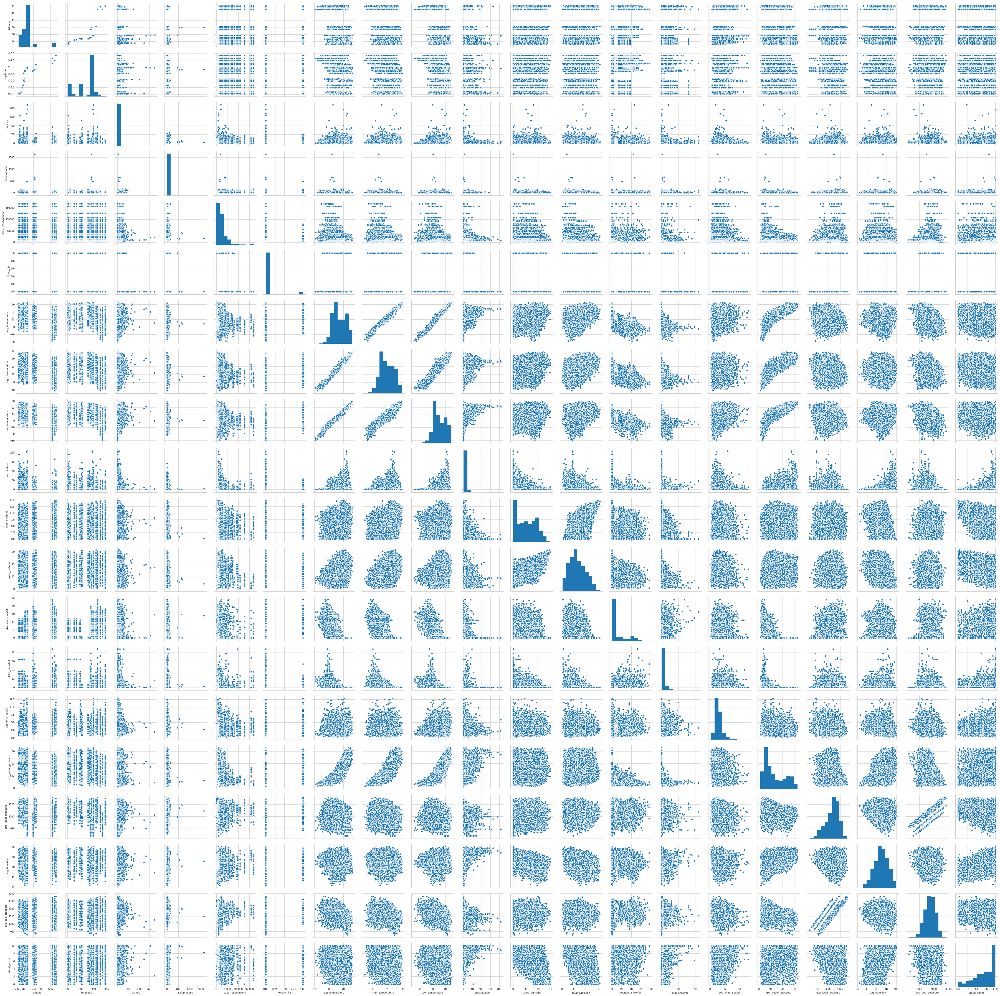

In [113]:
sns.pairplot(FF[Ordinal_Fields])

### Number of different stores visited each day

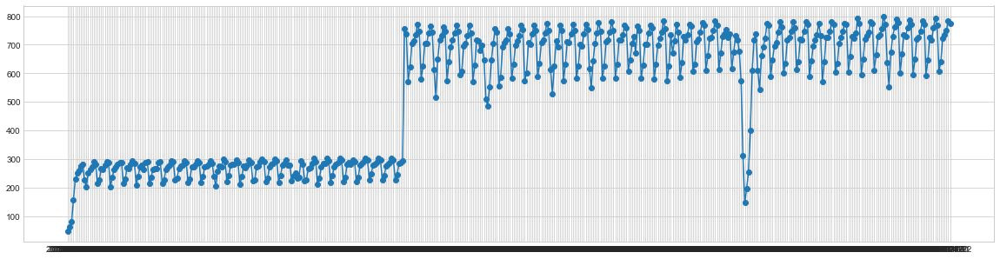

In [27]:
stores = FF.groupby([FF.visit_date.dt.strftime('%Y-%m-%d')])['air_store_id'].count().reset_index(name='number of different stores').sort_values('visit_date')
plt.figure(figsize=(20,5))
plt.plot_date(stores['visit_date'],stores['number of different stores'], linestyle='solid')

### Number of visitors each day

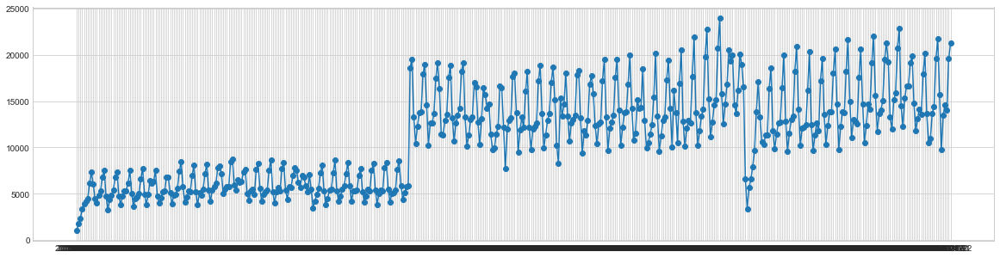

In [28]:
vis_day = FF.groupby([FF.visit_date.dt.strftime('%Y-%m-%d')])['visitors'].sum().reset_index(name='number of visitors').sort_values('visit_date')
plt.figure(figsize=(20,5))
plt.plot_date(vis_day['visit_date'],vis_day['number of visitors'], linestyle='solid')

### Average number of visitors each day

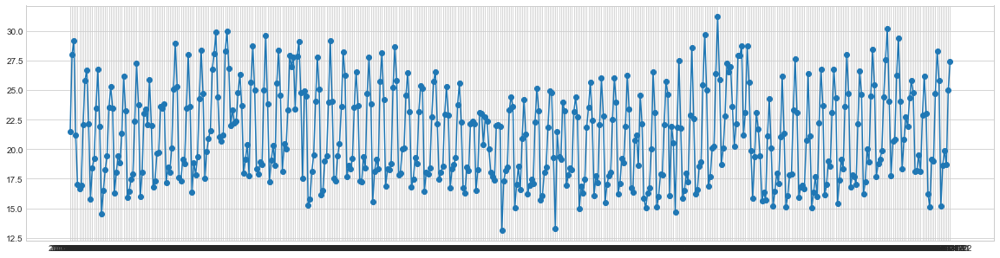

In [206]:
avg_vis_day = FF.groupby([FF.visit_date.dt.strftime('%Y-%m-%d')])['visitors'].mean().reset_index(name='avg_vis_day').sort_values('visit_date')
plt.figure(figsize=(20,5))
plt.plot_date(avg_vis_day['visit_date'],avg_vis_day['avg_vis_day'], linestyle='solid')

#### By looking at the three graphs above,<br/>I suspect that there's high corralation between 'number of different stores' and 'number of visitors'

In [18]:
# calculate spearman's correlation
coef, p = spearmanr(stores['number of different stores'], vis_day['number of visitors'])
print('Spearmans correlation coefficient: %.3f' % coef)
# interpret the significance
alpha = 0.05
if p > alpha:
    print('Samples are uncorrelated (fail to reject H0) p=%.3f' % p)
else:
    print('Samples are correlated (reject H0) p=%.3f' % p)


print('')
print('As we suspected, there is a high corralation between "number of different stores each day" and "number of visitors each day".')

NameError: name 'stores' is not defined

### Creating fields to further explore the data

In [14]:
FF['visit_date'] =  pd.to_datetime(FF['visit_date'], format = '%Y-%m-%d')
FF['year'] = FF['visit_date'].dt.year
FF['month'] = FF['visit_date'].dt.month
FF['week'] = FF['visit_date'].dt.week
FF['day'] = FF['visit_date'].dt.day
FF['day_of_week'] = FF['visit_date'].dt.day_name()
FF['area1'],FF['area2'],FF['area3'] = FF['air_area_name'].str.split('-').str
FF['area1_2'] =FF['area1']+"_"+FF['area2']
del FF['area3']

### Analyzing data per day of week.

In [15]:
vis_dow = FF.groupby(FF['day_of_week'])['visitors'].sum().reset_index(name='vis_dow').sort_values('day_of_week')
avg_vis_dow = FF.groupby(FF['day_of_week'])['visitors'].mean().reset_index(name='avg_vis_dow').sort_values('day_of_week')
med_vis_dow = FF.groupby(FF['day_of_week'])['visitors'].median().reset_index(name='med_vis_dow').sort_values('day_of_week')

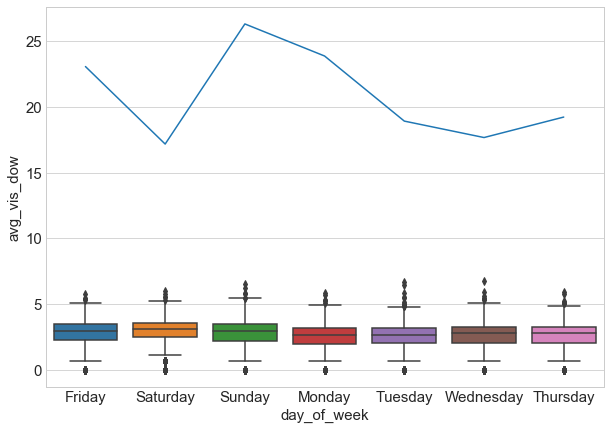

In [209]:
plt.rcParams.update({'font.size': 15})
plt.figure(figsize=(10,7))
sns.boxplot(FF['dow'], np.log(FF['visitors']))
sns.lineplot(med_vis_dow['day_of_week'], avg_vis_dow['avg_vis_dow'])

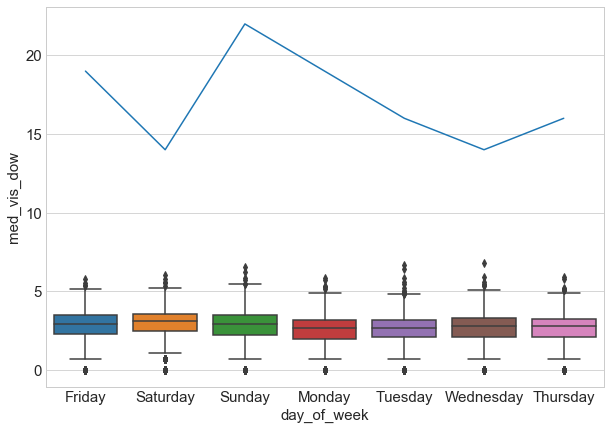

In [210]:
plt.rcParams.update({'font.size': 15})
plt.figure(figsize=(10,7))
sns.boxplot(FF['dow'], np.log(FF['visitors']))
sns.lineplot(med_vis_dow['day_of_week'], med_vis_dow['med_vis_dow'])

### Analyzing data per month.

In [16]:
avg_vis_month = FF.groupby(FF['month'])['visitors'].mean().reset_index(name='avg_vis_month').sort_values('month')
med_vis_month = FF.groupby(FF['month'])['visitors'].median().reset_index(name='med_vis_month').sort_values('month')

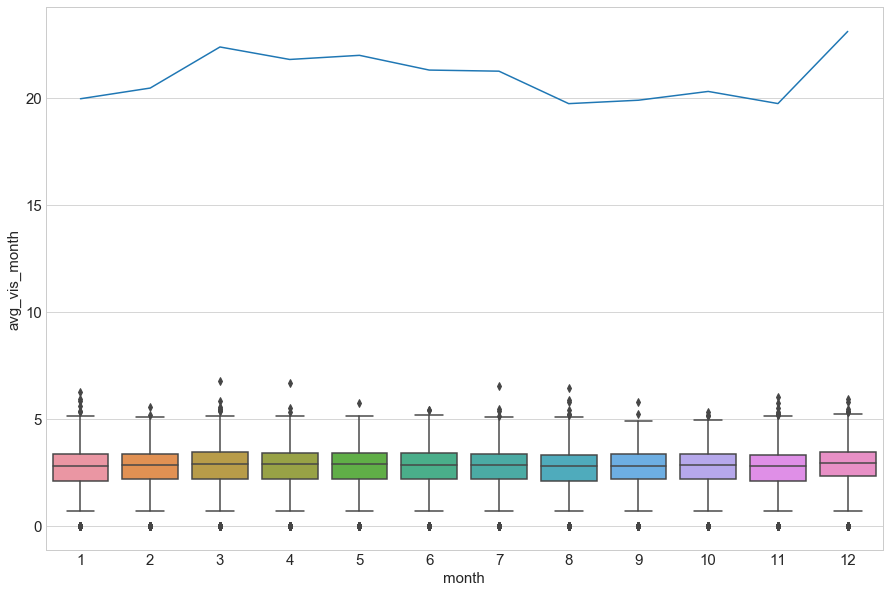

In [212]:
plt.rcParams.update({'font.size': 15})
plt.figure(figsize=(15,10))
sns.boxplot(FF['month'], np.log(FF['visitors']))
sns.lineplot(avg_vis_month['month']-1, avg_vis_month['avg_vis_month'])

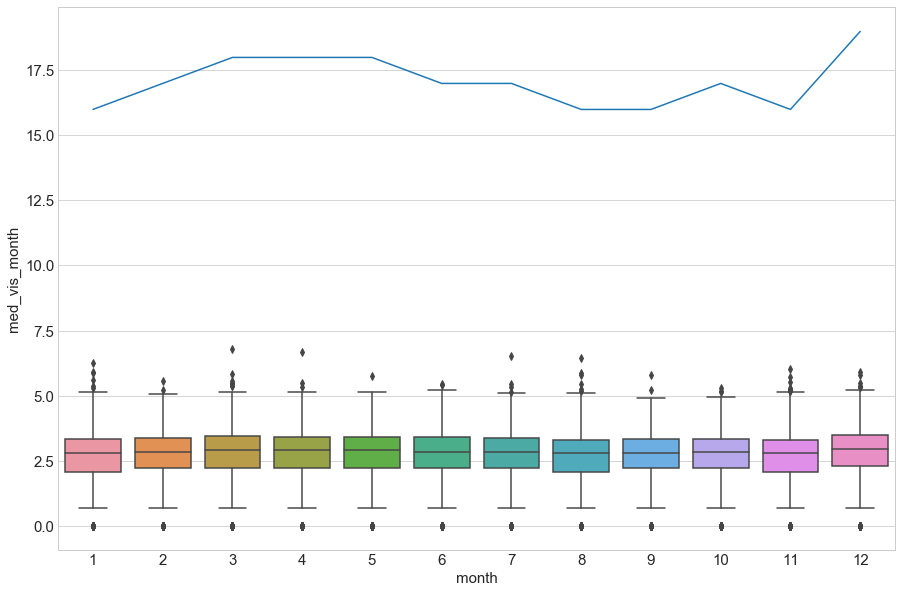

In [213]:
plt.rcParams.update({'font.size': 15})
plt.figure(figsize=(15,10))
sns.boxplot(FF['month'], np.log(FF['visitors']))
sns.lineplot(med_vis_month['month']-1, med_vis_month['med_vis_month'])

### Total number of reservations each day

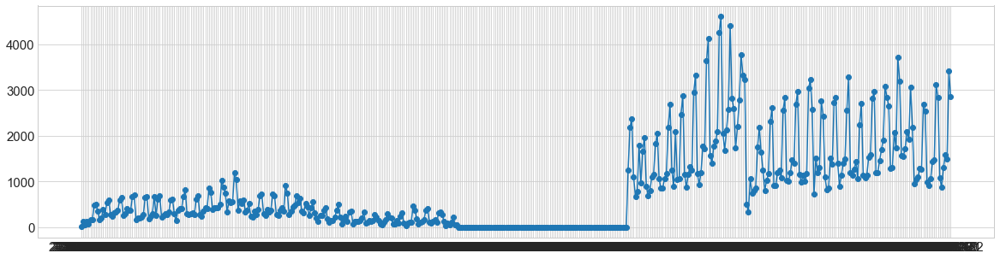

In [214]:
res_day = FF.groupby([FF.visit_date.dt.strftime('%Y-%m-%d')])['reservations'].sum().reset_index(name='number of reservations').sort_values('visit_date')
plt.figure(figsize=(20,5))
plt.plot_date(res_day['visit_date'],res_day['number of reservations'], linestyle='solid')

### Average number of reservations each day

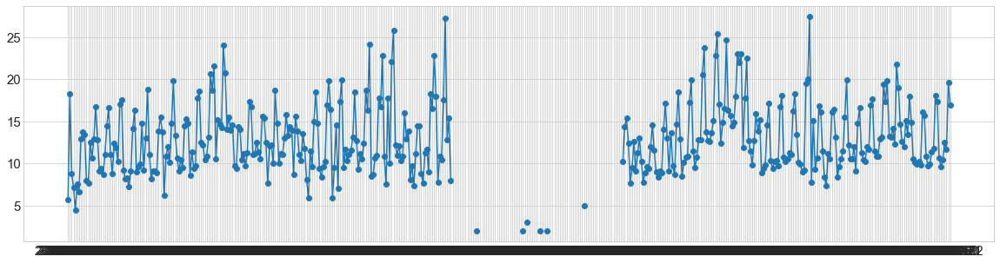

In [215]:
avg_res_day = FF.groupby([FF.visit_date.dt.strftime('%Y-%m-%d')])['reservations'].mean().reset_index(name='avg_res_day').sort_values('visit_date')
plt.figure(figsize=(20,5))
plt.plot_date(avg_res_day['visit_date'],avg_res_day['avg_res_day'], linestyle='solid')

### Graph of number of visitors per food genre by date

In [17]:
genres = FF.air_genre_name.unique()
vis_day_genre = FF.groupby(['visit_date','air_genre_name'])['visitors'].sum().reset_index(['visit_date','air_genre_name'])

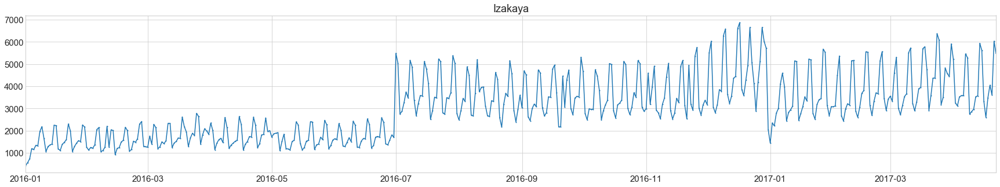

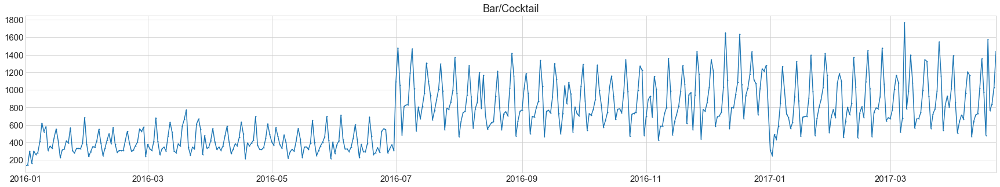

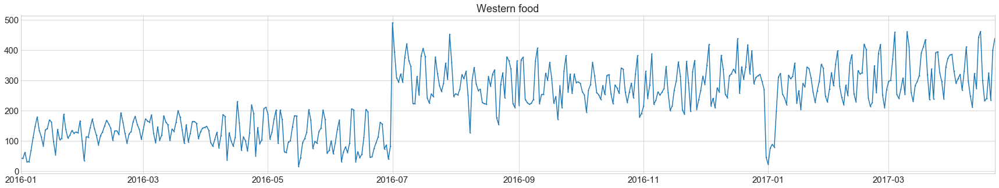

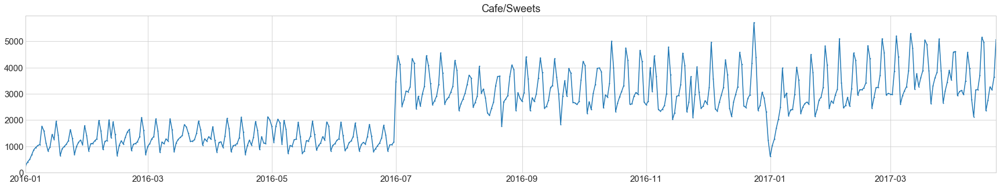

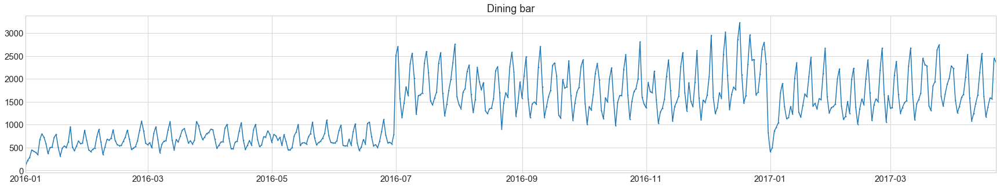

...

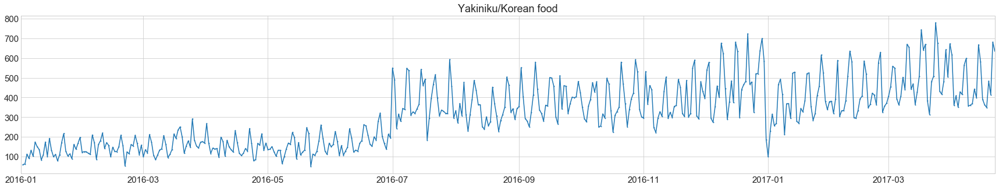

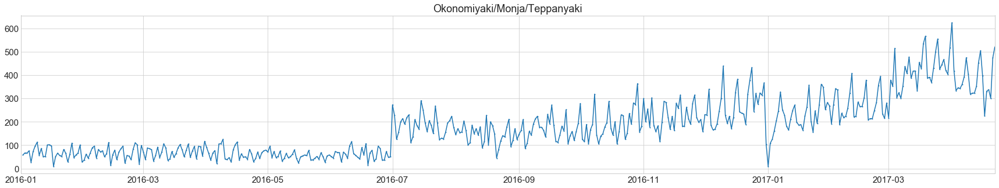

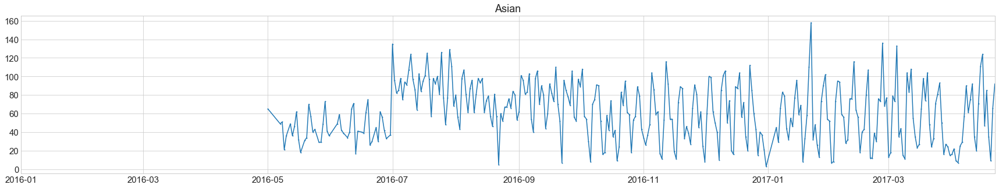

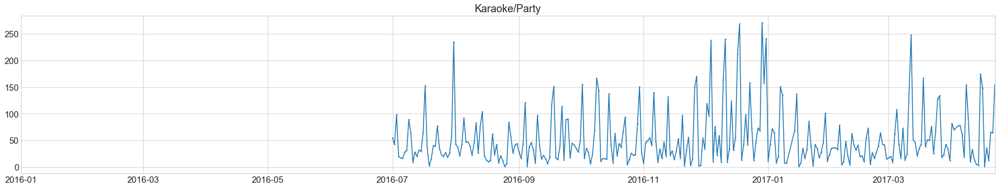

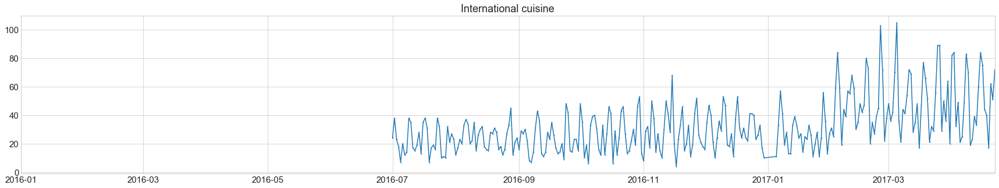

In [217]:
#plt.figure(figsize=(35,20))
#plt.yscale('log',basey=2) 
plt.rcParams.update({'font.size': 15})

#ax.xaxis.set_major_formatter(DateFormatter('%Y'))
datemin = dt.date(2016, 1, 1)
datemax = dt.date(2017, 4, 22)
#ax.set_xlim(datemin, datemax)

#x = 0
for i in genres:
    F = vis_day_genre[vis_day_genre.air_genre_name == i]

    plt.figure(figsize=(30,5))
    plt.xlim(datemin, datemax)    
    plt.plot_date(F['visit_date'],F['visitors'], linestyle='solid', ms=1, label = i)#, color = color)
    plt.title(i)
    #x = x + 1
    #plt.legend(i)



#plt.legend(loc='best')
#plt.plot_date(F['visit_date'],np.log(F['visitors']), linestyle='solid', ms=2)
#plt.legend(i)

### Graph of number of visitors per prefecture by date

In [23]:
area = FF.area1.unique()
vis_day_area1 = FF.groupby(['visit_date','area1'])['visitors'].sum().reset_index(['visit_date','area1'])

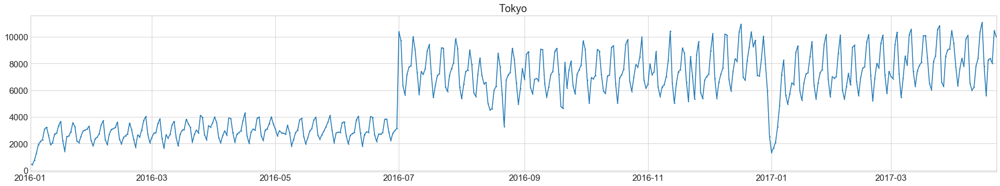

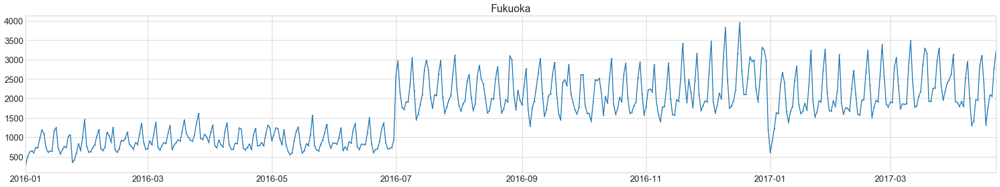

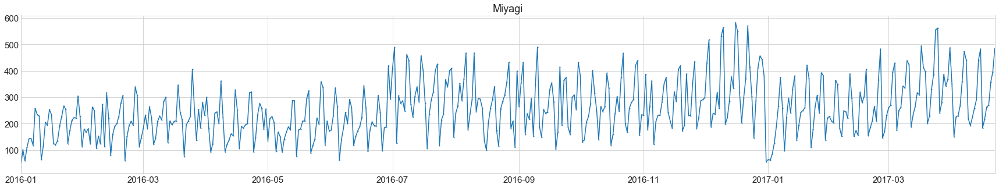

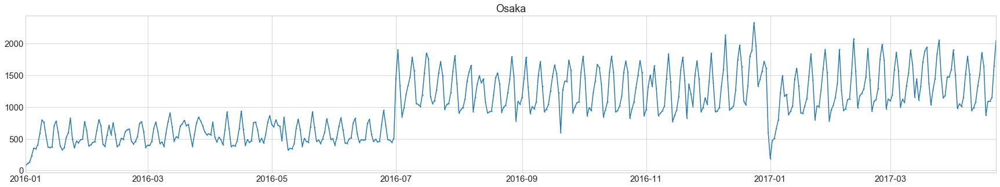

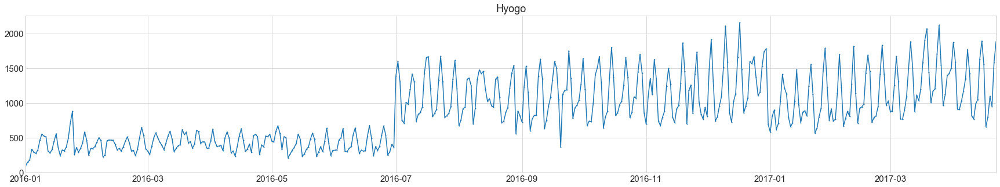

...

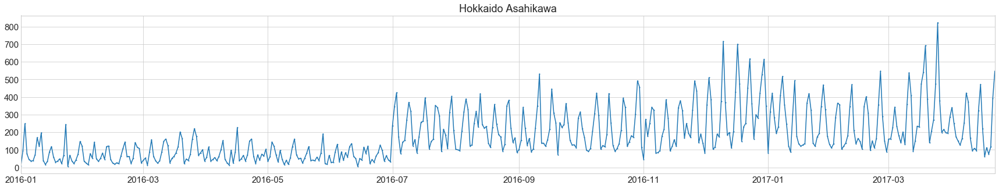

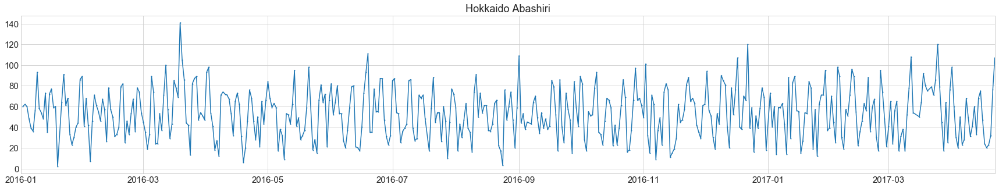

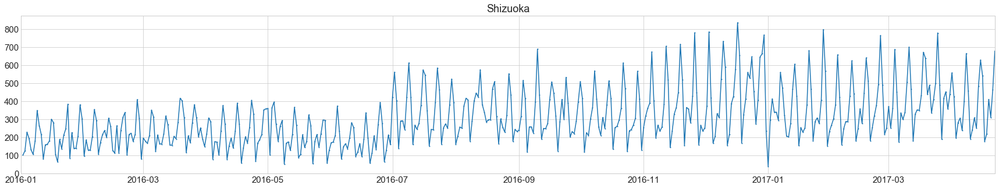

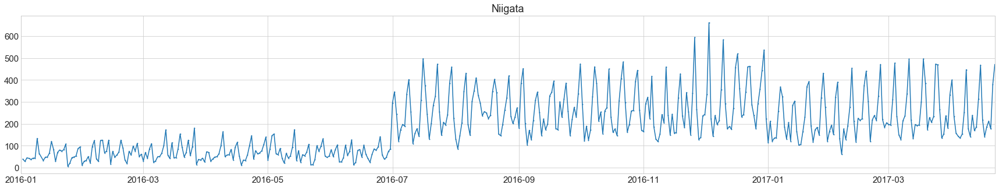

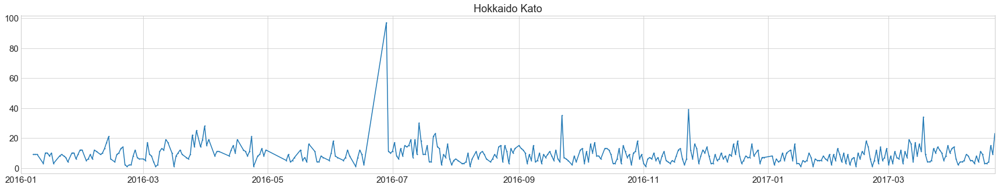

In [219]:
plt.rcParams.update({'font.size': 15})

#ax.xaxis.set_major_formatter(DateFormatter('%Y'))
datemin = dt.date(2016, 1, 1)
datemax = dt.date(2017, 4, 22)
#ax.set_xlim(datemin, datemax)

#x = 0
for i in area:
    F = vis_day_area1[vis_day_area1.area1 == i]

    plt.figure(figsize=(30,5))
    plt.xlim(datemin, datemax)    
    plt.plot_date(F['visit_date'],F['visitors'], linestyle='solid', ms=1, label = i)#, color = color)
    plt.title(i)

# _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _

# Feature Engineering

In [18]:
FF['is_rain'] = np.where(FF['precipitation'] > 0, 1, 0)
FF['is_snow'] = np.where(FF['total_snowfall'] > 0, 1, 0)

In [19]:
# Average Daily Visitors
# Median Daily Visitors
FF = pd.merge(FF, FF.groupby([FF['visit_date']])['visitors'].mean().reset_index(name='daily_avg_visitors').sort_values('visit_date'),  how='left', left_on='visit_date',right_on='visit_date')
FF = pd.merge(FF, FF.groupby([FF['visit_date']])['visitors'].median().reset_index(name='daily_median_visitors').sort_values('visit_date'),  how='left', left_on='visit_date',right_on='visit_date')

# Average Visitors per ['day_of_week']
# Average Visitors per ['air_genre_name']
# Average Visitors per ['area1']
FF = pd.merge(FF, FF.groupby([FF['day_of_week']])['visitors'].mean().reset_index(name='avg_visitors_day_of_week').sort_values('day_of_week'),  how='left', left_on='day_of_week',right_on='day_of_week')
FF = pd.merge(FF, FF.groupby([FF['area1']])['visitors'].mean().reset_index(name='avg_visitors_area1').sort_values('area1'),  how='left', left_on='area1',right_on='area1')
FF = pd.merge(FF, FF.groupby([FF['air_genre_name']])['visitors'].mean().reset_index(name='avg_visitors_genre').sort_values('air_genre_name'),  how='left', left_on='air_genre_name',right_on='air_genre_name')

# Median Visitors per ['day_of_week']
# Median Visitors per ['air_genre_name']
# Median Visitors per ['area1']
FF = pd.merge(FF, FF.groupby([FF['day_of_week']])['visitors'].median().reset_index(name='median_visitors_day_of_week').sort_values('day_of_week'),  how='left', left_on='day_of_week',right_on='day_of_week')
FF = pd.merge(FF, FF.groupby([FF['area1']])['visitors'].median().reset_index(name='median_visitors_area1').sort_values('area1'),  how='left', left_on='area1',right_on='area1')
FF = pd.merge(FF, FF.groupby([FF['air_genre_name']])['visitors'].median().reset_index(name='median_visitors_genre').sort_values('air_genre_name'),  how='left', left_on='air_genre_name',right_on='air_genre_name')

# Average Visitors per ['day_of_week','holiday']
# Average Visitors per ['air_genre_name','holiday']
# Average Visitors per ['area1','holiday']
FF = pd.merge(FF, FF.groupby([FF['day_of_week'],FF['holiday_flg']])['visitors'].mean().reset_index(name='avg_visitors_dow_holiday').sort_values('day_of_week'),  how='left', left_on=['day_of_week','holiday_flg'],right_on=['day_of_week','holiday_flg'])
FF = pd.merge(FF, FF.groupby([FF['area1'],FF['holiday_flg']])['visitors'].mean().reset_index(name='avg_visitors_area1_holiday').sort_values('area1'),  how='left', left_on=['area1','holiday_flg'],right_on=['area1','holiday_flg'])
FF = pd.merge(FF, FF.groupby([FF['air_genre_name'],FF['holiday_flg']])['visitors'].mean().reset_index(name='avg_visitors_genre_holiday').sort_values('air_genre_name'),  how='left', left_on=['air_genre_name','holiday_flg'],right_on=['air_genre_name','holiday_flg'])

# Median Visitors per ['day_of_week','holiday']
# Median Visitors per ['air_genre_name','holiday']
# Median Visitors per ['area1','holiday']
FF = pd.merge(FF, FF.groupby([FF['day_of_week'],FF['holiday_flg']])['visitors'].median().reset_index(name='median_visitors_dow_holiday').sort_values('day_of_week'),  how='left', left_on=['day_of_week','holiday_flg'],right_on=['day_of_week','holiday_flg'])
FF = pd.merge(FF, FF.groupby([FF['area1'],FF['holiday_flg']])['visitors'].median().reset_index(name='median_visitors_area1_holiday').sort_values('area1'),  how='left', left_on=['area1','holiday_flg'],right_on=['area1','holiday_flg'])
FF = pd.merge(FF, FF.groupby([FF['air_genre_name'],FF['holiday_flg']])['visitors'].median().reset_index(name='median_visitors_genre_holiday').sort_values('air_genre_name'),  how='left', left_on=['air_genre_name','holiday_flg'],right_on=['air_genre_name','holiday_flg'])

# Average Visitors per ['day_of_week','area1','holiday']
# Average Visitors per ['day_of_week','area1','air_genre_name','holiday']
# Average Visitors per ['day_of_week','area1']
# Average Visitors per ['day_of_week','area1','air_genre_name']
FF = pd.merge(FF, FF.groupby([FF['day_of_week'],FF['area1'],FF['holiday_flg']])['visitors'].mean().reset_index(name='avg_visitors_dow_area1_holiday').sort_values('day_of_week'),  how='left', left_on=['day_of_week','area1','holiday_flg'],right_on=['day_of_week','area1','holiday_flg'])
FF = pd.merge(FF, FF.groupby([FF['day_of_week'],FF['area1'],FF['air_genre_name'],FF['holiday_flg']])['visitors'].mean().reset_index(name='avg_visitors_dow_area1_genre_holiday').sort_values('day_of_week'),  how='left', left_on=['day_of_week','area1','air_genre_name','holiday_flg'],right_on=['day_of_week','area1','air_genre_name','holiday_flg'])
FF = pd.merge(FF, FF.groupby([FF['day_of_week'],FF['area1']])['visitors'].mean().reset_index(name='avg_visitors_dow_area1').sort_values('day_of_week'),  how='left', left_on=['day_of_week','area1'],right_on=['day_of_week','area1'])
FF = pd.merge(FF, FF.groupby([FF['day_of_week'],FF['area1'],FF['air_genre_name']])['visitors'].mean().reset_index(name='avg_visitors_dow_area1_genre').sort_values('day_of_week'),  how='left', left_on=['day_of_week','area1','air_genre_name'],right_on=['day_of_week','area1','air_genre_name'])

# Median Visitors per ['day_of_week','area1','holiday']
# Median Visitors per ['day_of_week','area1','air_genre_name','holiday']
# Median Visitors per ['day_of_week','area1']
# Median Visitors per ['day_of_week','area1','air_genre_name']
FF = pd.merge(FF, FF.groupby([FF['day_of_week'],FF['area1'],FF['holiday_flg']])['visitors'].median().reset_index(name='median_visitors_dow_area1_holiday').sort_values('day_of_week'),  how='left', left_on=['day_of_week','area1','holiday_flg'],right_on=['day_of_week','area1','holiday_flg'])
FF = pd.merge(FF, FF.groupby([FF['day_of_week'],FF['area1'],FF['air_genre_name'],FF['holiday_flg']])['visitors'].median().reset_index(name='median_visitors_dow_area1_genre_holiday').sort_values('day_of_week'),  how='left', left_on=['day_of_week','area1','air_genre_name','holiday_flg'],right_on=['day_of_week','area1','air_genre_name','holiday_flg'])
FF = pd.merge(FF, FF.groupby([FF['day_of_week'],FF['area1']])['visitors'].median().reset_index(name='median_visitors_dow_area1').sort_values('day_of_week'),  how='left', left_on=['day_of_week','area1'],right_on=['day_of_week','area1'])
FF = pd.merge(FF, FF.groupby([FF['day_of_week'],FF['area1'],FF['air_genre_name']])['visitors'].median().reset_index(name='median_visitors_dow_area1_genre').sort_values('day_of_week'),  how='left', left_on=['day_of_week','area1','air_genre_name'],right_on=['day_of_week','area1','air_genre_name'])

# Average Visitors per ['air_store_id']
# Median Visitors per ['air_store_id']
FF = pd.merge(FF, FF.groupby([FF['air_store_id']])['visitors'].mean().reset_index(name='avg_visitors_per_store').sort_values('air_store_id'),  how='left', left_on='air_store_id',right_on='air_store_id')
FF = pd.merge(FF, FF.groupby([FF['air_store_id']])['visitors'].median().reset_index(name='median_visitors_per_store').sort_values('air_store_id'),  how='left', left_on='air_store_id',right_on='air_store_id')
# Average Visitors per ['air_store_id','day_of_week']
# Median Visitors per ['air_store_id','day_of_week']
FF = pd.merge(FF, FF.groupby([FF['air_store_id'],FF['day_of_week']])['visitors'].mean().reset_index(name='avg_visitors_per_store_dow').sort_values('air_store_id'),  how='left', left_on=['air_store_id','day_of_week'],right_on=['air_store_id','day_of_week'])
FF = pd.merge(FF, FF.groupby([FF['air_store_id'],FF['day_of_week']])['visitors'].median().reset_index(name='median_visitors_per_store_dow').sort_values('air_store_id'),  how='left', left_on=['air_store_id','day_of_week'],right_on=['air_store_id','day_of_week'])

# latitude-longitude as category
#FF['lat_long'] = FF['st_lat'].astype(str) + ' ' + FF['st_long'].astype(str)

In [20]:
make_one_hot(FF,'day_of_week')
make_one_hot(FF,'air_genre_name')
make_one_hot(FF,'area1')
make_one_hot(FF,'area1_2')

In [21]:
finaltest = FF.loc[FF['visit_date'] >= '2017-04-01']
finaltest.to_csv("D:\\EndProject\\finaltest.csv", encoding='utf-8', index=False)
#del finaltest['visitors']

In [28]:
FF.to_csv("D:\\EndProject\\FF.csv", encoding='utf-8', index=False)
print(FF.shape)
FF.head()

(252108, 157)


,air_store_id,air_genre_name,air_area_name,latitude,longitude,visit_date,visitors,reservations,daily_reservations,dow,holiday_flg,station_id,st_lat,st_long,st_vincenty,location,avg_temperature,high_temperature,low_temperature,precipitation,hours_sunlight,solar_radiation,deepest_snowfall,total_snowfall,avg_wind_speed,avg_vapor_pressure,avg_local_pressure,avg_humidity,avg_sea_pressure,cloud_cover,year,month,week,day,day_of_week,area1,area2,area1_2,is_rain,is_snow,daily_avg_visitors,daily_median_visitors,avg_visitors_day_of_week,avg_visitors_area1,avg_visitors_genre,median_visitors_day_of_week,median_visitors_area1,median_visitors_genre,avg_visitors_dow_holiday,avg_visitors_area1_holiday,avg_visitors_genre_holiday,median_visitors_dow_holiday,median_visitors_area1_holiday,median_visitors_genre_holiday,avg_visitors_dow_area1_holiday,avg_visitors_dow_area1_genre_holiday,avg_visitors_dow_area1,avg_visitors_dow_area1_genre,median_visitors_dow_area1_holiday,median_visitors_dow_area1_genre_holiday,median_visitors_dow_area1,median_visitors_dow_area1_genre,avg_visitors_per_store,median_visitors_per_store,avg_visitors_per_store_dow,median_visitors_per_store_dow,Friday,Saturday,Sunday,Monday,Tuesday,Wednesday,Thursday,Izakaya,Bar/Cocktail,Western food,Cafe/Sweets,Dining bar,Italian/French,Other,Japanese food,Creative cuisine,Yakiniku/Korean food,Okonomiyaki/Monja/Teppanyaki,Asian,Karaoke/Party,International cuisine,Tokyo,Fukuoka,Miyagi,Osaka,Hyogo,Hiroshima,Hokkaido Sapporo,Hokkaido Asahikawa,Hokkaido Abashiri,Shizuoka,Niigata,Hokkaido Kato,Tokyo_to Nerima,Fukuoka_ken Fukuoka,Miyagi_ken Sendai,Fukuoka_ken Kurume,Osaka_fu Neyagawa,Tokyo_to Shinjuku,Tokyo_to Shibuya,Hyogo_ken Kobe,Tokyo_to Chiyoda,Hyogo_ken Takarazuka,Hiroshima_ken Hiroshima,Tokyo_to Setagaya,Osaka_fu Osaka,Tokyo_to Bunkyo,Hiroshima_ken Fukuyama,Hokkaido Sapporo_shi Minami 3 Jonishi,Tokyo_to Suginami,Tokyo_to Minato,Tokyo_to Nakano,Tokyo_to Toshima,Tokyo_to Taito,Hokkaido Asahikawa_shi 6 Jodori,Hyogo_ken Nishinomiya,Hokkaido Abashiri_shi Minami 6 Johigashi,Shizuoka_ken Shizuoka,Fukuoka_ken Yame,Shizuoka_ken Hamamatsu,Tokyo_to Meguro,Tokyo_to Chūo,Niigata_ken Niigata,Tokyo_to Koto,Fukuoka_ken Itoshima,Fukuoka_ken Kitakyūshū,Tokyo_to Koganei,Hyogo_ken Kakogawa,Tokyo_to Itabashi,Tokyo_to Ota,Niigata_ken Nagaoka,Tokyo_to Machida,Osaka_fu Higashiosaka,Tokyo_to Shinagawa,Tokyo_to Tachikawa,Tokyo_to Katsushika,Shizuoka_ken Numazu,Hyogo_ken Himeji,Hokkaido Sapporo_shi Kotoni 2 Jo,Osaka_fu Sakai,Hokkaido Kato_gun Motomachi,Niigata_ken Kashiwazaki,Tokyo_to Kita,Tokyo_to Musashino,Tokyo_to Adachi,Hokkaido Sapporo_shi Atsubetsuchūo 1 Jo,Tokyo_to Edogawa,Osaka_fu Suita,Hokkaido Sapporo_shi Kita 24 Jonishi,Hyogo_ken Amagasaki,Tokyo_to Fuchū
0,air_04341b588bde96cd,Izakaya,Tokyo-to Nerima-ku Toyotamakita,35.735623,139.651658,2016-01-01,10,NaN,510,Friday,1,tokyo__nerima-kana__nerima,35.738333,139.591667,5.435240,8,3.187121,7.681061,-1.059848,1.225434,5.992623,9.9275,15.933333,3.866667,2.478689,4.794118,1007.864706,57.470588,1025.793750,3.266667,2016,1,53,1,Friday,Tokyo,to Nerima,Tokyo_to Nerima,1,1,21.520833,14.0,23.072737,20.484162,23.082850,19,17,19,27.436732,21.790612,25.719780,23,17.0,21,24.144785,26.113333,22.586283,26.940110,20.0,22.5,19.0,24.0,35.870763,34.0,41.855072,41.0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
1,air_05c325d315cc17f5,Izakaya,Fukuoka-ken Fukuoka-shi Daimyo,33.589216,130.392813,2016-01-01,29,NaN,510,Friday,1,fukuoka__fukuoka-kana__fukuoka,33.581667,130.375000,1.853535,0,5.919167,12.322500,0.771667,0.007194,7.541905,11.1700,0.000000,0.000000,1.673333,7.096000,1017.864000,73.800000,1031.179167,3.200000,2016,1,53,1,Friday,Fukuoka,ken Fukuoka,Fukuoka_ken Fukuoka,1,0,21.520833,14.0,23.072737,20.434758,23.082850,19,16,19,27.436732,23.373394,25.719780,23,19.0,21,27.712177,36.471429,22.234855,30.044944,23.0,35.0,18.0,27.0,22.495726,22.0,2

## Creating two flatfiles!

In [22]:
FF_NR = FF.copy()
del FF_NR['reservations']

In [23]:
#FF_OR = FF.loc[(FF['visit_date'] >= '2016-10-27') & (FF['reservations'] != 0)]
FF_OR = FF.loc[FF['reservations'].notnull()]

# Outliers Detection and Treatment

## Univariet outlier detection

## Statistical Tests

In [24]:
# creating a vector of ordinal values for univariant outlier detection (FF_OR)
FF_OR_Ordinal_Fields = ['visitors','reservations','daily_reservations','st_vincenty','avg_temperature','high_temperature',
                  'low_temperature','precipitation','hours_sunlight','solar_radiation','deepest_snowfall','total_snowfall','avg_wind_speed','avg_vapor_pressure','avg_local_pressure',
                  'avg_humidity','avg_sea_pressure','cloud_cover']

# creating a vector of ordinal values for univariant outlier detection (FF_NR)
FF_NR_Ordinal_Fields = ['visitors','daily_reservations','st_vincenty','avg_temperature','high_temperature',
                  'low_temperature','precipitation','hours_sunlight','solar_radiation','deepest_snowfall','total_snowfall','avg_wind_speed','avg_vapor_pressure','avg_local_pressure',
                  'avg_humidity','avg_sea_pressure','cloud_cover']

In [30]:
Automatic_Normality_Test(FF_NR_Ordinal_Fields,FF_NR,3)

visitors   -6 /6 tests came negative, data does not look normal
daily_reservations   -6 /6 tests came negative, data does not look normal
st_vincenty   -6 /6 tests came negative, data does not look normal
avg_temperature   -6 /6 tests came negative, data does not look normal
high_temperature   -6 /6 tests came negative, data does not look normal
low_temperature   -6 /6 tests came negative, data does not look normal
precipitation   -6 /6 tests came negative, data does not look normal
hours_sunlight   -6 /6 tests came negative, data does not look normal
solar_radiation   -6 /6 tests came negative, data does not look normal
deepest_snowfall   -6 /6 tests came negative, data does not look normal
total_snowfall   -6 /6 tests came negative, data does not look normal
avg_wind_speed   -6 /6 tests came negative, data does not look normal
avg_vapor_pressure   -6 /6 tests came negative, data does not look normal
avg_local_pressure   -6 /6 tests came negative, data does not look normal
avg_humidit

In [31]:
Automatic_Normality_Test(FF_OR_Ordinal_Fields,FF_OR,3)

visitors   -6 /6 tests came negative, data does not look normal
reservations   -6 /6 tests came negative, data does not look normal
daily_reservations   -6 /6 tests came negative, data does not look normal
st_vincenty   -6 /6 tests came negative, data does not look normal
avg_temperature   -6 /6 tests came negative, data does not look normal
high_temperature   -6 /6 tests came negative, data does not look normal
low_temperature   -6 /6 tests came negative, data does not look normal
precipitation   -6 /6 tests came negative, data does not look normal
hours_sunlight   -6 /6 tests came negative, data does not look normal
solar_radiation   -6 /6 tests came negative, data does not look normal
deepest_snowfall   -6 /6 tests came negative, data does not look normal
total_snowfall   -6 /6 tests came negative, data does not look normal
avg_wind_speed   -6 /6 tests came negative, data does not look normal
avg_vapor_pressure   -6 /6 tests came negative, data does not look normal
avg_local_pressur

## visual test

#### According to the pairplot observations we made,<br/>we found that the fields: 'avg_local_pressure', 'avg_humidity', 'avg_sea_pressure'<br/>appear to have normal distribution.
#### But they failed the statistical normality tests.

### No-reservations flatfile

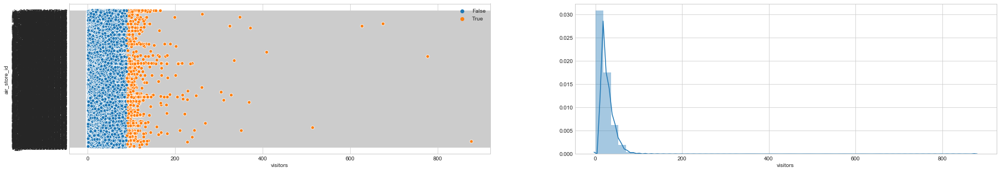

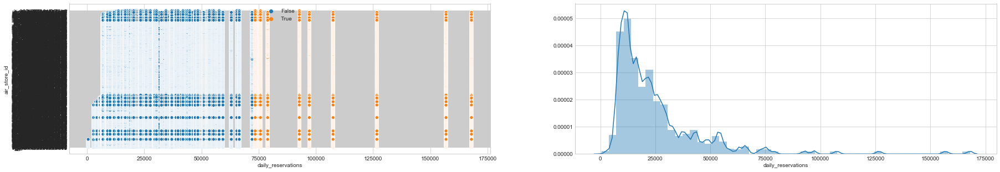

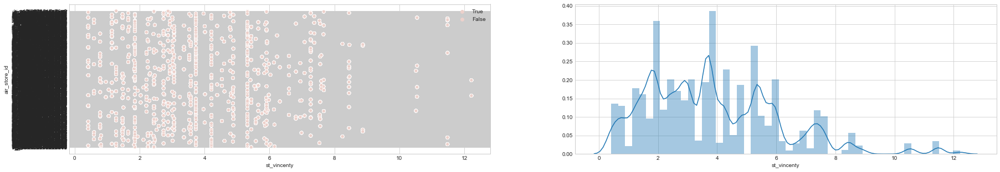

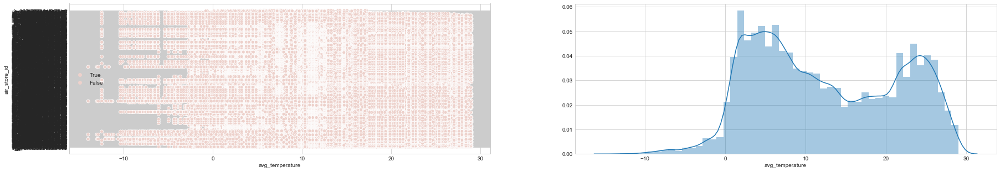

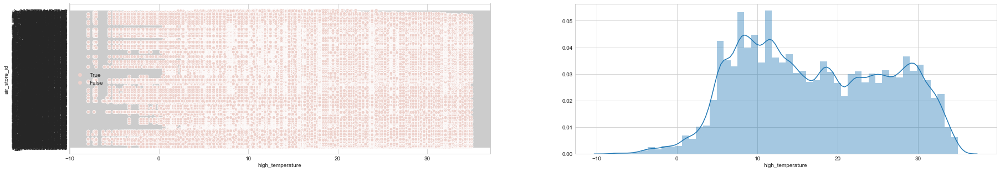

...

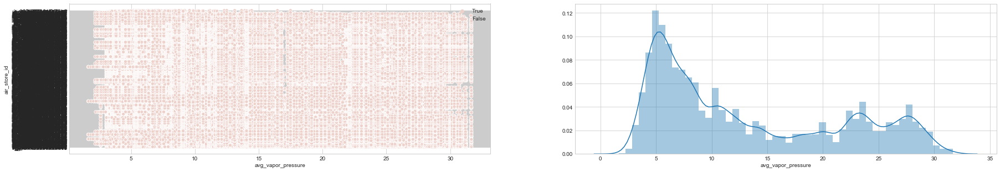

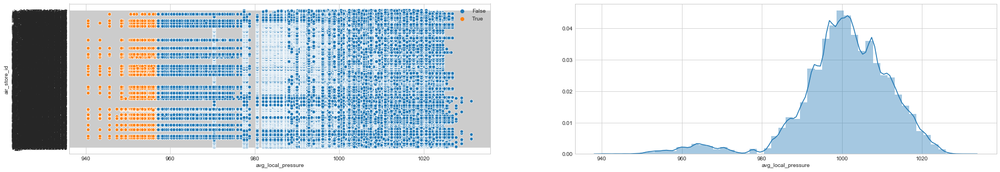

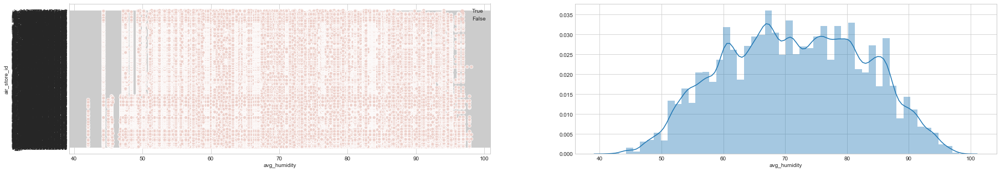

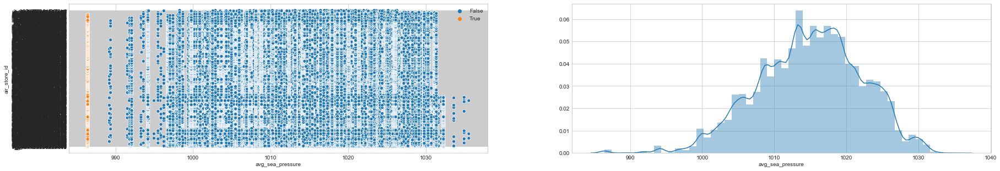

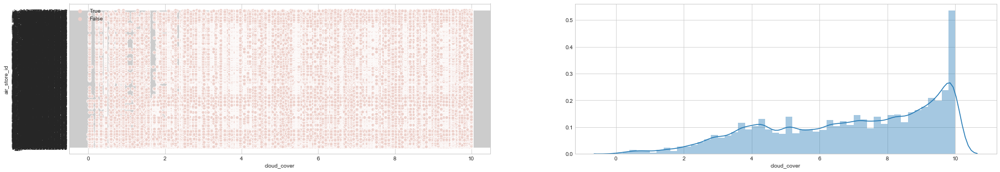

In [43]:
plot_outliers(FF_NR_Ordinal_Fields,FF_NR,[3,2.75,2.25,1.5,1.5,1.5,3,1.75,1.5,3,3,2.75,1.25,3,1.5,2.25,1.75])

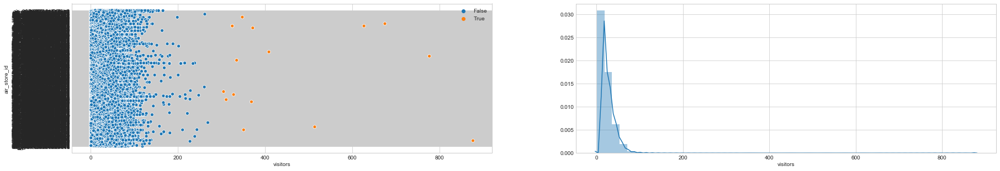

In [52]:
plot_outliers(['visitors'],FF_NR,[12])

In [53]:
print("Number of outliers according to IRQ for visitors is: " , np.sum(iqr_outliers(FF_NR['visitors'],k=3,return_thresholds=False)))
print("Number of outliers according to IRQ for daily reservations is: " , np.sum(iqr_outliers(FF_NR['daily_reservations'],k=2.75,return_thresholds=False)))
print("Number of outliers according to IRQ for station vincenty is: " , np.sum(iqr_outliers(FF_NR['st_vincenty'],k=2.25,return_thresholds=False)))
print("Number of outliers according to IRQ for average temperature is: " , np.sum(iqr_outliers(FF_NR['avg_temperature'],k=1.5,return_thresholds=False)))
print("Number of outliers according to IRQ for maximum temperature is: " , np.sum(iqr_outliers(FF_NR['high_temperature'],k=1.5,return_thresholds=False)))

print("Number of outliers according to IRQ for minimum temperature is: " , np.sum(iqr_outliers(FF_NR['low_temperature'],k=1.5,return_thresholds=False)))
print("Number of outliers according to IRQ for precipitation is: " , np.sum(iqr_outliers(FF_NR['precipitation'],k=3,return_thresholds=False)))
print("Number of outliers according to IRQ for hours of sunlight is: " , np.sum(iqr_outliers(FF_NR['hours_sunlight'],k=1.75,return_thresholds=False)))
print("Number of outliers according to IRQ for solar radiation is: " , np.sum(iqr_outliers(FF_NR['solar_radiation'],k=1.5,return_thresholds=False)))
print("Number of outliers according to IRQ for deepest snowfall is: " , np.sum(iqr_outliers(FF_NR['deepest_snowfall'],k=3,return_thresholds=False)))

print("Number of outliers according to IRQ for total snowfall is: " , np.sum(iqr_outliers(FF_NR['total_snowfall'],k=3,return_thresholds=False)))
print("Number of outliers according to IRQ for average wind speed is: " , np.sum(iqr_outliers(FF_NR['avg_wind_speed'],k=2.75,return_thresholds=False)))
print("Number of outliers according to IRQ for average vapor pressure is: " , np.sum(iqr_outliers(FF_NR['avg_vapor_pressure'],k=1.25,return_thresholds=False)))
print("Number of outliers according to IRQ for average local pressure is: " , np.sum(iqr_outliers(FF_NR['avg_local_pressure'],k=3,return_thresholds=False)))
print("Number of outliers according to IRQ for for average humidity is: " , np.sum(iqr_outliers(FF_NR['avg_humidity'],k=1.5,return_thresholds=False)))

print("Number of outliers according to IRQ for for average sea pressure is: " , np.sum(iqr_outliers(FF_NR['avg_sea_pressure'],k=2.5,return_thresholds=False)))
print("Number of outlier according to IRQs for cloud cover is: " , np.sum(iqr_outliers(FF_NR['cloud_cover'],k=1.75,return_thresholds=False)))

Number of outliers according to IRQ for visitors is:  925
Number of outliers according to IRQ for daily reservations is:  5312
Number of outliers according to IRQ for station vincenty is:  0
Number of outliers according to IRQ for average temperature is:  0
Number of outliers according to IRQ for maximum temperature is:  0
Number of outliers according to IRQ for minimum temperature is:  0
Number of outliers according to IRQ for precipitation is:  15273
Number of outliers according to IRQ for hours of sunlight is:  0
Number of outliers according to IRQ for solar radiation is:  0
Number of outliers according to IRQ for deepest snowfall is:  21725
Number of outliers according to IRQ for total snowfall is:  35761
Number of outliers according to IRQ for average wind speed is:  637
Number of outliers according to IRQ for average vapor pressure is:  0
Number of outliers according to IRQ for average local pressure is:  1771
Number of outliers according to IRQ for for average humidity is:  0
Nu

In [ ]:
['visitors','daily_reservations','precipitation','deepest_snowfall','total_snowfall','avg_wind_speed','avg_local_pressure']

In [54]:
#FF_NR.loc[iqr_outliers(FF_NR['visitors'],k=3,return_thresholds=False), 'visitors'] = np.nan
temp = FF_NR.copy()

In [55]:
temp.loc[iqr_outliers(temp['visitors'],k=12,return_thresholds=False), 'visitors'] = np.nan

In [258]:
temp.loc[iqr_outliers(temp['visitors'],k=3,return_thresholds=False), 'visitors'] = np.nan
temp.loc[iqr_outliers(temp['daily_reservations'],k=2.75,return_thresholds=False), 'daily_reservations'] = np.nan
temp.loc[iqr_outliers(temp['precipitation'],k=3,return_thresholds=False), 'precipitation'] = np.nan
temp.loc[iqr_outliers(temp['deepest_snowfall'],k=3,return_thresholds=False), 'deepest_snowfall'] = np.nan
temp.loc[iqr_outliers(temp['total_snowfall'],k=3,return_thresholds=False), 'total_snowfall'] = np.nan
temp.loc[iqr_outliers(temp['avg_wind_speed'],k=2.75,return_thresholds=False), 'avg_wind_speed'] = np.nan
temp.loc[iqr_outliers(temp['avg_local_pressure'],k=3,return_thresholds=False), 'avg_local_pressure'] = np.nan

### Missing Values

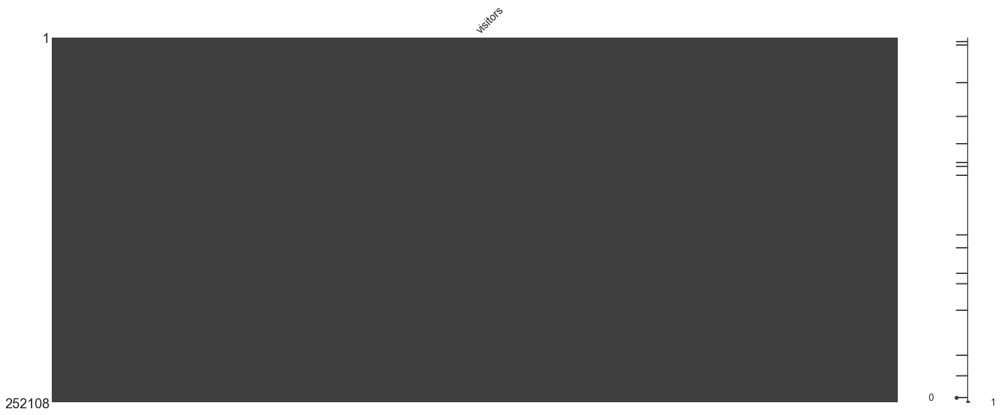

In [56]:
### plot the missingness (nullity) matrix
missingdata_df_NR = temp.columns[temp.isnull().any()].tolist()
msno.matrix(temp[missingdata_df_NR])

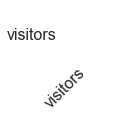

In [57]:
## missingness correlation heatmap
msno.heatmap(temp[missingdata_df_NR], figsize=(len(missingdata_df_NR),len(missingdata_df_NR)))

In [58]:
temp2=temp.copy()
# drop rows with missing values
temp2.dropna(inplace=True)
# summarize the number of rows and columns in the dataset
print(temp2.shape)

(252092, 156)


In [52]:
### check for changes in the statistics
display(pd.DataFrame(temp.describe()))
#print("----------------------------------------------------------------------------------")
display(pd.DataFrame(temp2.describe()))
display(pd.DataFrame(temp2.describe())/pd.DataFrame(temp.describe()))

,latitude,longitude,visitors,daily_reservations,st_lat,st_long,st_vincenty,avg_temperature,high_temperature,low_temperature,precipitation,hours_sunlight,solar_radiation,deepest_snowfall,total_snowfall,avg_wind_speed,avg_vapor_pressure,avg_local_pressure,avg_humidity,avg_sea_pressure,cloud_cover,month,week,day
count,252108.000000,252108.000000,251183.000000,246796.000000,252108.000000,252108.000000,252108.000000,252108.000000,252108.000000,252108.000000,236835.000000,252108.000000,252108.000000,230383.000000,216347.000000,251471.000000,252108.000000,250337.000000,252108.000000,252108.000000,252108.000000,252108.000000,252108.000000,252108.000000
mean,35.613121,137.357865,20.621037,22702.563064,35.614647,137.357938,3.821379,12.437472,17.191895,8.220057,2.969936,4.824140,12.821108,8.795198,0.276736,2.277930,13.095185,1000.903139,71.458947,1014.954251,6.906527,6.208200,25.001043,15.591830
std,2.044473,3.671577,15.363870,14575.861060,2.044327,3.671401,2.197806,8.881032,9.013641,9.282349,3.919908,3.082495,6.257907,17.299180,0.614378,0.728539,8.340493,11.092719,11.147393,7.133973,2.441930,3.680263,16.008416,8.670745
min,33.211967,130.195555,1.000000,510.000000,33.225000,130.190000,0.416011,-13.983333,-7.913636,-20.627273,0.000000,0.000000,0.894000,0.000000,0.000000,1.035878,1.637500,957.175000,42.050000,986.418750,0.000000,1.000000,1.000000,1.000000
25%,34.692337,135.341564,9.000000,11890.000000,34.681667,135.335000,1.939005,4.829545,9.530000,0.351515,0.195205,2.195082,8.061250,0.000000,0.000000,1.753608,5.917647,995.571429,62.705882,1010.118750,4.977778,3.000000,10.000000,8.000000
50%,35.658068,139.670038,17.000000,18192.000000,35.691667,139.620000,3.573166,10.907576,16.370455,6.033000,1.497006,4.883333,11.890000,0.000000,0.000000,2.094656,10.033333,1001.370588,71.294118,1015.390476,7.309091,7.000000,26.000000,16.000000
75%,35.694003,139.751599,29.000000,28149.000000,35.691667,139.750000,5.319959,21.110606,25.033000,17.677273,3.937500,7.025410,17.472000,8.062500,0.229167,2.662000,20.840000,1007.988235,80.190476,1019.957143,9.120000,10.000000,39.000000,23.000000
max,44.020632,144.273398,89.000000,75791.000000,44.016667,144.278333,12.217263,29.012605,34.959167,25.179832,19.358333,13.279000,30.410000,69.055556,3.235294,5.130000,31.658333,1031.300000,98.125000,1035.550000,10.000000,12.000000,53.000000,31.000000


,latitude,longitude,visitors,daily_reservations,st_lat,st_long,st_vincenty,avg_temperature,high_temperature,low_temperature,precipitation,hours_sunlight,solar_radiation,deepest_snowfall,total_snowfall,avg_wind_speed,avg_vapor_pressure,avg_local_pressure,avg_humidity,avg_sea_pressure,cloud_cover,month,week,day
count,188143.000000,188143.000000,188143.000000,188143.000000,188143.000000,188143.000000,188143.000000,188143.000000,188143.000000,188143.000000,188143.000000,188143.000000,188143.000000,188143.000000,188143.000000,188143.000000,188143.000000,188143.000000,188143.000000,188143.000000,188143.000000,188143.000000,188143.000000,188143.000000
mean,35.525918,137.019969,20.759348,22175.523586,35.526947,137.020272,3.747396,14.552710,19.522350,10.205825,2.803980,5.224588,13.970402,6.032876,0.237265,2.142789,14.545773,1001.758692,72.145090,1015.457210,6.949451,6.825021,27.643941,15.432687
std,2.047567,3.806649,15.423598,14132.013841,2.047679,3.806541,2.217856,8.160238,8.177436,8.665459,4.110020,3.152396,6.342972,14.245522,0.565041,0.664243,8.092427,11.162571,10.119553,6.938009,2.428350,3.399608,14.797982,8.879700
min,33.211967,130.195555,1.000000,510.000000,33.225000,130.190000,0.416011,-13.983333,-7.913636,-20.627273,0.000000,0.000000,1.390000,0.000000,0.000000,1.035878,1.637500,957.175000,42.050000,991.775000,0.000000,1.000000,1.000000,1.000000
25%,34.681261,135.187254,9.000000,11649.000000,34.681667,135.211667,1.853535,7.472000,12.590756,2.568182,0.108844,2.590164,8.782000,0.000000,0.000000,1.692000,7.352941,996.388235,64.750000,1010.725000,5.136364,4.000000,14.000000,7.000000
50%,35.646572,139.653247,17.000000,17882.000000,35.626667,139.620000,3.529102,13.711364,19.237121,8.962121,1.003731,5.287603,13.378750,0.000000,0.000000,1.980833,11.920000,1002.194118,72.450000,1015.637500,7.371429,7.000000,29.000000,15.000000
75%,35.693840,139.751599,29.000000,27903.000000,35.691667,139.750000,5.319959,22.243478,26.686000,19.063636,3.451807,7.687097,18.937500,1.062500,0.072727,2.428333,22.568000,1009.400000,80.000000,1020.381250,9.066667,10.000000,41.000000,23.000000
max,44.020632,144.273398,89.000000,75791.000000,44.016667,144.278333,12.217263,29.012605,34.959167,25.179832,19.358333,13.279000,30.410000,68.681159,3.235294,5.130000,31.256000,1031.300000,97.500000,1035.550000,10.000000,12.000000,53.000000,31.000000


,latitude,longitude,visitors,daily_reservations,st_lat,st_long,st_vincenty,avg_temperature,high_temperature,low_temperature,precipitation,hours_sunlight,solar_radiation,deepest_snowfall,total_snowfall,avg_wind_speed,avg_vapor_pressure,avg_local_pressure,avg_humidity,avg_sea_pressure,cloud_cover,month,week,day
count,0.746279,0.746279,0.749028,0.762342,0.746279,0.746279,0.746279,0.746279,0.746279,0.746279,0.794405,0.746279,0.746279,0.816653,0.869635,0.748170,0.746279,0.751559,0.746279,0.746279,0.746279,0.746279,0.746279,0.746279
mean,0.997551,0.997540,1.006707,0.976785,0.997538,0.997542,0.980640,1.170070,1.135555,1.241576,0.944121,1.083009,1.089641,0.685928,0.857371,0.940674,1.110773,1.000855,1.009602,1.000496,1.006215,1.099356,1.105712,0.989793
std,1.001514,1.036789,1.003888,0.969549,1.001639,1.036809,1.009123,0.918839,0.907229,0.933542,1.048499,1.022677,1.013593,0.823480,0.919696,0.911747,0.970258,1.006297,0.907795,0.972531,0.994439,0.923740,0.924388,1.024099
min,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,NaN,NaN,1.554810,NaN,NaN,1.000000,1.000000,1.000000,1.000000,1.005430,NaN,1.000000,1.000000,1.000000
25%,0.999681,0.998860,1.000000,0.979731,1.000000,0.999089,0.955921,1.547144,1.321171,7.306034,0.557584,1.179985,1.089409,NaN,NaN,0.964868,1.242545,1.000820,1.032598,1.000600,1.031859,1.333333,1.400000,0.875000
50%,0.999678,0.999880,1.000000,0.982960,0.998179,1.000000,0.987668,1.257050,1.175112,1.485517,0.670493,1.082786,1.125210,NaN,NaN,0.945660,1.188040,1.000822,1.016213,1.000243,1.008529,1.000000,1.115385,0.937500
75%,0.999995,1.000000,1.000000,0.991261,1.000000,1.000000,1.000000,1.053664,1.066033,1.078426,0.876649,1.094185,1.083877,0.131783,0.317355,0.912221,1.082917,1.001401,0.997625,1.000416,0.994152,1.000000,1.051282,1.000000
max,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,0.994578,1.000000,1.000000,0.987291,1.000000,0.993631,1.000000,1.000000,1.000000,1.000000,1.000000


In [59]:
V_Imp = ['visitors','daily_reservations','precipitation','deepest_snowfall','total_snowfall','avg_wind_speed','avg_local_pressure']
V_Imp = ['visitors']

In [60]:
temp2 = FF_NR.copy()
train = temp[FF_NR_Ordinal_Fields].copy()
train.dropna(inplace=True)

In [61]:
for coly in V_Imp:
    reg = KNeighborsRegressor(n_neighbors=5)
    
    x_train = train.drop(coly, axis=1)
    colx = x_train.columns
    y_train = train[coly]
    
    x_test = temp.loc[(temp[coly].isnull()),(colx)]
    x_test = x_test.dropna(axis='columns')
    
    x_train = x_train[x_test.columns]
    reg.fit(x_train, y_train)
    pred=reg.predict(x_test)
    x_test[coly] = pred
    
    if coly in ['visitors','reservations','daily_reservations']:
        x_test[coly] = np.round(pred,0)    
        
    C = temp[[coly]]
    C.dropna(inplace=True)
    C = pd.concat([C,x_test[[coly]]])
    temp2[coly] = C

In [62]:
FF_NR = temp2.copy()

In [63]:
FF_NR.isnull().sum().sum()

0

## Reservations only flatfile

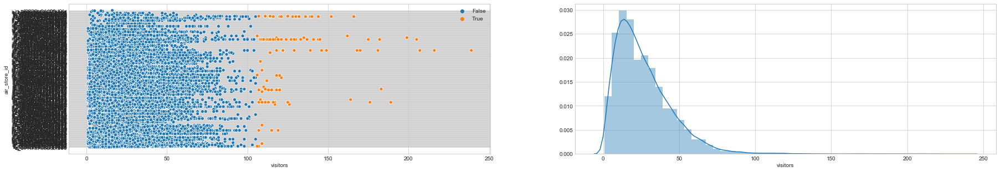

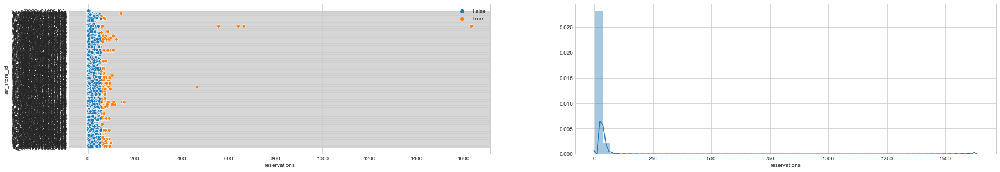

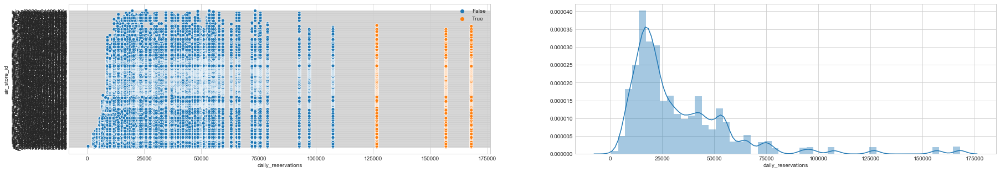

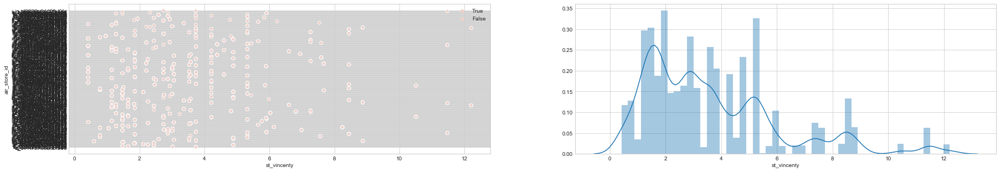

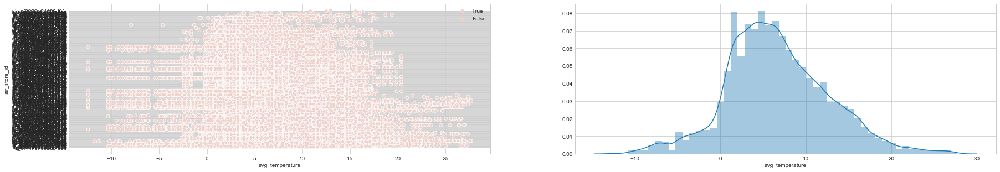

...

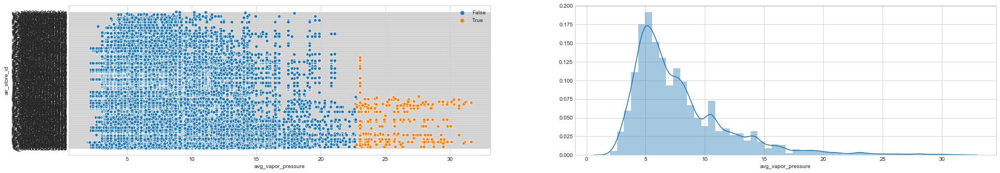

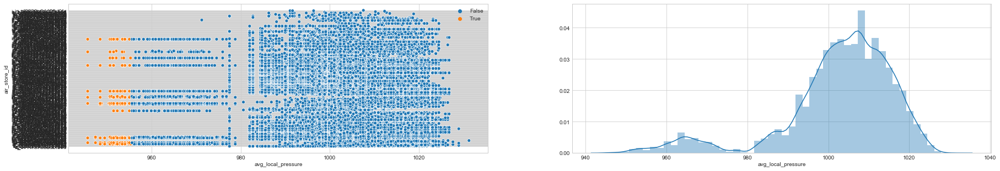

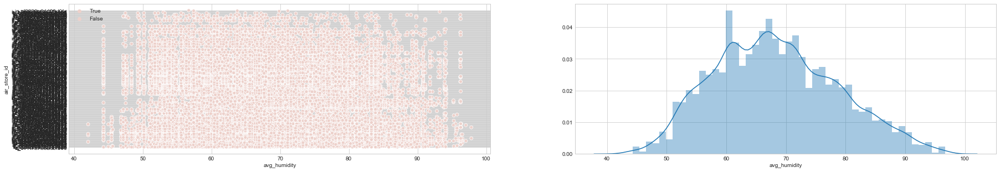

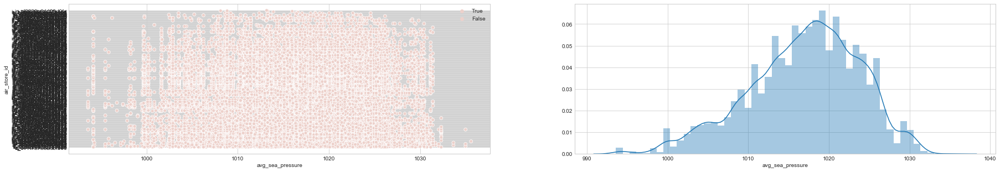

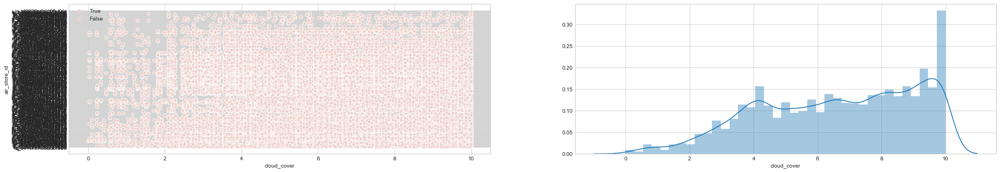

In [278]:
plot_outliers(FF_OR_Ordinal_Fields,FF_OR,[3,3,3,2.5,2.5,2.25,3,3,2,2.25,3,3,3,3,3,1.5,2.25,1.75])

In [279]:
print("Number of outliers according to IRQ for visitors is: " , np.sum(iqr_outliers(FF_OR['visitors'],k=3,return_thresholds=False)))
print("Number of outliers according to IRQ for reservations is: " , np.sum(iqr_outliers(FF_OR['reservations'],k=3,return_thresholds=False)))
print("Number of outliers according to IRQ for daily reservations is: " , np.sum(iqr_outliers(FF_OR['daily_reservations'],k=3,return_thresholds=False)))
print("Number of outliers according to IRQ for station vincenty is: " , np.sum(iqr_outliers(FF_OR['st_vincenty'],k=2.5,return_thresholds=False)))
print("Number of outliers according to IRQ for average temperature is: " , np.sum(iqr_outliers(FF_OR['avg_temperature'],k=2.5,return_thresholds=False)))

print("Number of outliers according to IRQ for maximum temperature is: " , np.sum(iqr_outliers(FF_OR['high_temperature'],k=2.25,return_thresholds=False)))
print("Number of outliers according to IRQ for minimum temperature is: " , np.sum(iqr_outliers(FF_OR['low_temperature'],k=3,return_thresholds=False)))
print("Number of outliers according to IRQ for precipitation is: " , np.sum(iqr_outliers(FF_OR['precipitation'],k=3,return_thresholds=False)))
print("Number of outliers according to IRQ for hours of sunlight is: " , np.sum(iqr_outliers(FF_OR['hours_sunlight'],k=2,return_thresholds=False)))
print("Number of outliers according to IRQ for solar radiation is: " , np.sum(iqr_outliers(FF_OR['solar_radiation'],k=2.25,return_thresholds=False)))

print("Number of outliers according to IRQ for deepest snowfall is: " , np.sum(iqr_outliers(FF_OR['deepest_snowfall'],k=3,return_thresholds=False)))
print("Number of outliers according to IRQ for total snowfall is: " , np.sum(iqr_outliers(FF_OR['total_snowfall'],k=3,return_thresholds=False)))
print("Number of outliers according to IRQ for average wind speed is: " , np.sum(iqr_outliers(FF_OR['avg_wind_speed'],k=3,return_thresholds=False)))
print("Number of outliers according to IRQ for average vapor pressure is: " , np.sum(iqr_outliers(FF_OR['avg_vapor_pressure'],k=3,return_thresholds=False)))
print("Number of outliers according to IRQ for average local pressure is: " , np.sum(iqr_outliers(FF_OR['avg_local_pressure'],k=3,return_thresholds=False)))

print("Number of outliers according to IRQ for for average humidity is: " , np.sum(iqr_outliers(FF_OR['avg_humidity'],k=1.5,return_thresholds=False)))
print("Number of outliers according to IRQ for for average sea pressure is: " , np.sum(iqr_outliers(FF_OR['avg_sea_pressure'],k=2.25,return_thresholds=False)))
print("Number of outlier according to IRQs for cloud cover is: " , np.sum(iqr_outliers(FF_OR['cloud_cover'],k=1.75,return_thresholds=False)))

Number of outliers according to IRQ for visitors is:  113
Number of outliers according to IRQ for reservations is:  289
Number of outliers according to IRQ for daily reservations is:  548
Number of outliers according to IRQ for station vincenty is:  0
Number of outliers according to IRQ for average temperature is:  0
Number of outliers according to IRQ for maximum temperature is:  0
Number of outliers according to IRQ for minimum temperature is:  0
Number of outliers according to IRQ for precipitation is:  1577
Number of outliers according to IRQ for hours of sunlight is:  0
Number of outliers according to IRQ for solar radiation is:  0
Number of outliers according to IRQ for deepest snowfall is:  0
Number of outliers according to IRQ for total snowfall is:  1893
Number of outliers according to IRQ for average wind speed is:  65
Number of outliers according to IRQ for average vapor pressure is:  342
Number of outliers according to IRQ for average local pressure is:  219
Number of outli

In [ ]:
['visitors','reservations','daily_reservations','precipitation','total_snowfall','avg_wind_speed','avg_vapor_pressure','avg_local_pressure']

In [281]:
temp = FF_OR.copy()

In [282]:
temp.loc[iqr_outliers(temp['visitors'],k=3,return_thresholds=False), 'visitors'] = np.nan
temp.loc[iqr_outliers(temp['reservations'],k=3,return_thresholds=False), 'reservations'] = np.nan
temp.loc[iqr_outliers(temp['daily_reservations'],k=3,return_thresholds=False), 'daily_reservations'] = np.nan
temp.loc[iqr_outliers(temp['precipitation'],k=3,return_thresholds=False), 'precipitation'] = np.nan
temp.loc[iqr_outliers(temp['total_snowfall'],k=3,return_thresholds=False), 'total_snowfall'] = np.nan
temp.loc[iqr_outliers(temp['avg_wind_speed'],k=3,return_thresholds=False), 'avg_wind_speed'] = np.nan
temp.loc[iqr_outliers(temp['avg_vapor_pressure'],k=3,return_thresholds=False), 'avg_vapor_pressure'] = np.nan
temp.loc[iqr_outliers(temp['avg_local_pressure'],k=3,return_thresholds=False), 'avg_local_pressure'] = np.nan

### Missing Values

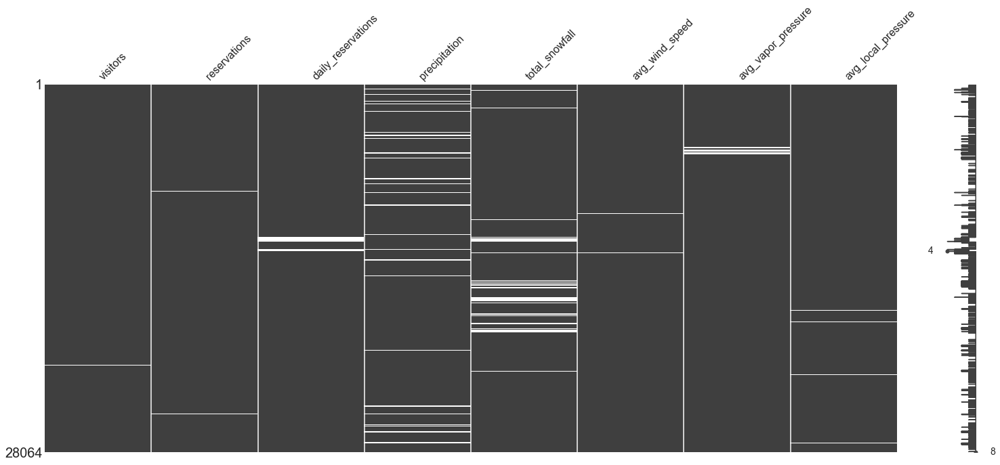

In [283]:
### plot the missingness (nullity) matrix
missingdata_df_OR = temp.columns[temp.isnull().any()].tolist()
msno.matrix(temp[missingdata_df_OR])

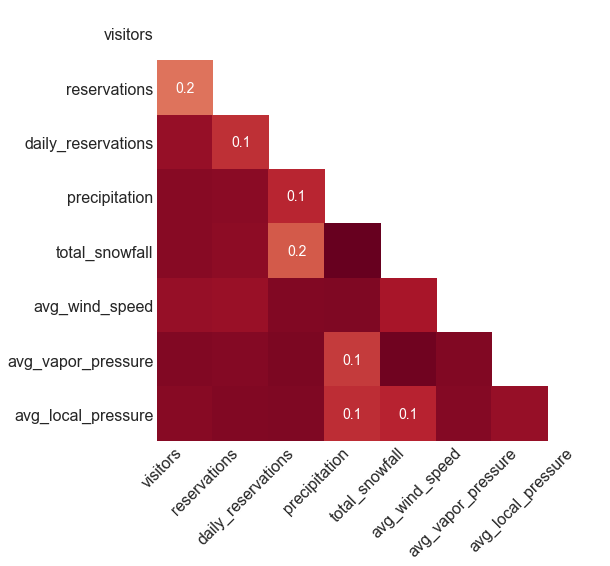

In [284]:
## missingness correlation heatmap
msno.heatmap(temp[missingdata_df_OR], figsize=(len(missingdata_df_OR),len(missingdata_df_OR)))

In [285]:
temp2=temp.copy()
# drop rows with missing values
temp2.dropna(inplace=True)
# summarize the number of rows and columns in the dataset
print(temp2.shape)

(23690, 152)


In [286]:
### check for changes in the statistics
display(pd.DataFrame(temp.describe()))
#print("----------------------------------------------------------------------------------")
display(pd.DataFrame(temp2.describe()))
display(pd.DataFrame(temp2.describe())/pd.DataFrame(temp.describe()))

,latitude,longitude,visitors,reservations,daily_reservations,st_lat,st_long,st_vincenty,avg_temperature,high_temperature,low_temperature,precipitation,hours_sunlight,solar_radiation,deepest_snowfall,total_snowfall,avg_wind_speed,avg_vapor_pressure,avg_local_pressure,avg_humidity,avg_sea_pressure,cloud_cover,year,month,week,day,is_rain,is_snow,daily_avg_visitors,daily_median_visitors,avg_visitors_day_of_week,avg_visitors_area1,avg_visitors_genre,median_visitors_day_of_week,median_visitors_area1,median_visitors_genre,avg_visitors_dow_holiday,avg_visitors_area1_holiday,avg_visitors_genre_holiday,median_visitors_dow_holiday,median_visitors_area1_holiday,median_visitors_genre_holiday,avg_visitors_dow_area1_holiday,avg_visitors_dow_area1_genre_holiday,avg_visitors_dow_area1,avg_visitors_dow_area1_genre,median_visitors_dow_area1_holiday,median_visitors_dow_area1_genre_holiday,median_visitors_dow_area1,median_visitors_dow_area1_genre,avg_visitors_per_store,median_visitors_per_store,avg_visitors_per_store_dow,median_visitors_per_store_dow,Friday,Saturday,Sunday,Monday,Tuesday,Wednesday,Izakaya,Bar/Cocktail,Western food,Cafe/Sweets,Dining bar,Italian/French,Other,Japanese food,Creative cuisine,Yakiniku/Korean food,Okonomiyaki/Monja/Teppanyaki,Asian,Karaoke/Party,Tokyo,Fukuoka,Miyagi,Osaka,Hyogo,Hiroshima,Hokkaido Sapporo,Hokkaido Asahikawa,Hokkaido Abashiri,Shizuoka,Niigata,Tokyo_to Nerima,Fukuoka_ken Fukuoka,Miyagi_ken Sendai,Fukuoka_ken Kurume,Osaka_fu Neyagawa,Tokyo_to Shinjuku,Tokyo_to Shibuya,Hyogo_ken Kobe,Tokyo_to Chiyoda,Hyogo_ken Takarazuka,Hiroshima_ken Hiroshima,Tokyo_to Setagaya,Osaka_fu Osaka,Tokyo_to Bunkyo,Hiroshima_ken Fukuyama,Hokkaido Sapporo_shi Minami 3 Jonishi,Tokyo_to Suginami,Tokyo_to Minato,Tokyo_to Nakano,Tokyo_to Toshima,Tokyo_to Taito,Hokkaido Asahikawa_shi 6 Jodori,Hyogo_ken Nishinomiya,Hokkaido Abashiri_shi Minami 6 Johigashi,Shizuoka_ken Shizuoka,Fukuoka_ken Yame,Shizuoka_ken Hamamatsu,Tokyo_to Meguro,Tokyo_to Chūo,Niigata_ken Niigata,Tokyo_to Koto,Fukuoka_ken Itoshima,Fukuoka_ken Kitakyūshū,Tokyo_to Koganei,Hyogo_ken Kakogawa,Tokyo_to Itabashi,Tokyo_to Ota,Niigata_ken Nagaoka,Tokyo_to Machida,Osaka_fu Higashiosaka,Tokyo_to Shinagawa,Tokyo_to Tachikawa,Tokyo_to Katsushika,Shizuoka_ken Numazu,Hyogo_ken Himeji,Hokkaido Sapporo_shi Kotoni 2 Jo,Osaka_fu Sakai,Hokkaido Kato_gun Motomachi,Niigata_ken Kashiwazaki,Tokyo_to Kita,Tokyo_to Musashino,Tokyo_to Adachi,Hokkaido Sapporo_shi Atsubetsuchūo 1 Jo,Tokyo_to Edogawa,Osaka_fu Suita,Hokkaido Sapporo_shi Kita 24 Jonishi,Hyogo_ken Amagasaki
count,28064.000000,28064.000000,27951.000000,27775.000000,27516.000000,28064.000000,28064.000000,28064.000000,28064.000000,28064.000000,28064.000000,26487.000000,28064.000000,28064.000000,28064.000000,26171.000000,27999.000000,27722.000000,27845.000000,28064.000000,28064.000000,28064.000000,28064.000000,28064.000000,28064.000000,28064.000000,28064.000000,28064.000000,28064.000000,28064.000000,28064.000000,28064.000000,28064.000000,28064.000000,28064.000000,28064.000000,28064.000000,28064.000000,28064.000000,28064.000000,28064.000000,28064.000000,28064.000000,28064.000000,28064.000000,28064.000000,28064.000000,28064.000000,28064.000000,28064.000000,28064.000000,28064.000000,28064.000000,28064.000000,28064.000000,28064.000000,28064.000000,28064.000000,28064.000000,28064.000000,28064.000000,28064.000000,28064.000000,28064.000000,28064.000000,28064.000000,28064.000000,28064.000000,28064.000000,28064.000000,28064.000000,28064.000000,28064.000000,28064.000000,28064.000000,28064.000000,28064.000000,28064.000000,28064.000000,28064.000000,28064.000000,28064.000000,28064.000000,28064.000000,28064.000000,28064.000000,28064.000000,28064.000000,28064.0,28064.000000,28064.000000,28064.000000,28064.000000,28064.000000,28064.000000,28064.000000,28064.000000,28064.0,28064.000000,28064.000000,28064.000000,28064.000000,28064.000000,28064.000000,28064.000000,28064.000000,28064.000000,28064.000000,28064.000000,28064.000000,28064.000000,28064.000000,28

,latitude,longitude,visitors,reservations,daily_reservations,st_lat,st_long,st_vincenty,avg_temperature,high_temperature,low_temperature,precipitation,hours_sunlight,solar_radiation,deepest_snowfall,total_snowfall,avg_wind_speed,avg_vapor_pressure,avg_local_pressure,avg_humidity,avg_sea_pressure,cloud_cover,year,month,week,day,is_rain,is_snow,daily_avg_visitors,daily_median_visitors,avg_visitors_day_of_week,avg_visitors_area1,avg_visitors_genre,median_visitors_day_of_week,median_visitors_area1,median_visitors_genre,avg_visitors_dow_holiday,avg_visitors_area1_holiday,avg_visitors_genre_holiday,median_visitors_dow_holiday,median_visitors_area1_holiday,median_visitors_genre_holiday,avg_visitors_dow_area1_holiday,avg_visitors_dow_area1_genre_holiday,avg_visitors_dow_area1,avg_visitors_dow_area1_genre,median_visitors_dow_area1_holiday,median_visitors_dow_area1_genre_holiday,median_visitors_dow_area1,median_visitors_dow_area1_genre,avg_visitors_per_store,median_visitors_per_store,avg_visitors_per_store_dow,median_visitors_per_store_dow,Friday,Saturday,Sunday,Monday,Tuesday,Wednesday,Izakaya,Bar/Cocktail,Western food,Cafe/Sweets,Dining bar,Italian/French,Other,Japanese food,Creative cuisine,Yakiniku/Korean food,Okonomiyaki/Monja/Teppanyaki,Asian,Karaoke/Party,Tokyo,Fukuoka,Miyagi,Osaka,Hyogo,Hiroshima,Hokkaido Sapporo,Hokkaido Asahikawa,Hokkaido Abashiri,Shizuoka,Niigata,Tokyo_to Nerima,Fukuoka_ken Fukuoka,Miyagi_ken Sendai,Fukuoka_ken Kurume,Osaka_fu Neyagawa,Tokyo_to Shinjuku,Tokyo_to Shibuya,Hyogo_ken Kobe,Tokyo_to Chiyoda,Hyogo_ken Takarazuka,Hiroshima_ken Hiroshima,Tokyo_to Setagaya,Osaka_fu Osaka,Tokyo_to Bunkyo,Hiroshima_ken Fukuyama,Hokkaido Sapporo_shi Minami 3 Jonishi,Tokyo_to Suginami,Tokyo_to Minato,Tokyo_to Nakano,Tokyo_to Toshima,Tokyo_to Taito,Hokkaido Asahikawa_shi 6 Jodori,Hyogo_ken Nishinomiya,Hokkaido Abashiri_shi Minami 6 Johigashi,Shizuoka_ken Shizuoka,Fukuoka_ken Yame,Shizuoka_ken Hamamatsu,Tokyo_to Meguro,Tokyo_to Chūo,Niigata_ken Niigata,Tokyo_to Koto,Fukuoka_ken Itoshima,Fukuoka_ken Kitakyūshū,Tokyo_to Koganei,Hyogo_ken Kakogawa,Tokyo_to Itabashi,Tokyo_to Ota,Niigata_ken Nagaoka,Tokyo_to Machida,Osaka_fu Higashiosaka,Tokyo_to Shinagawa,Tokyo_to Tachikawa,Tokyo_to Katsushika,Shizuoka_ken Numazu,Hyogo_ken Himeji,Hokkaido Sapporo_shi Kotoni 2 Jo,Osaka_fu Sakai,Hokkaido Kato_gun Motomachi,Niigata_ken Kashiwazaki,Tokyo_to Kita,Tokyo_to Musashino,Tokyo_to Adachi,Hokkaido Sapporo_shi Atsubetsuchūo 1 Jo,Tokyo_to Edogawa,Osaka_fu Suita,Hokkaido Sapporo_shi Kita 24 Jonishi,Hyogo_ken Amagasaki
count,23690.000000,23690.000000,23690.000000,23690.000000,23690.000000,23690.000000,23690.000000,23690.000000,23690.000000,23690.000000,23690.000000,23690.000000,23690.000000,23690.000000,23690.000000,23690.000000,23690.000000,23690.000000,23690.000000,23690.000000,23690.000000,23690.000000,23690.000000,23690.000000,23690.000000,23690.000000,23690.000000,23690.000000,23690.000000,23690.000000,23690.000000,23690.000000,23690.000000,23690.000000,23690.000000,23690.000000,23690.000000,23690.000000,23690.000000,23690.000000,23690.000000,23690.000000,23690.000000,23690.000000,23690.000000,23690.000000,23690.000000,23690.000000,23690.000000,23690.000000,23690.000000,23690.000000,23690.000000,23690.000000,23690.000000,23690.000000,23690.000000,23690.000000,23690.000000,23690.000000,23690.000000,23690.000000,23690.000000,23690.000000,23690.000000,23690.000000,23690.000000,23690.000000,23690.000000,23690.000000,23690.000000,23690.000000,23690.000000,23690.000000,23690.000000,23690.000000,23690.000000,23690.000000,23690.000000,23690.000000,23690.000000,23690.000000,23690.000000,23690.000000,23690.000000,23690.000000,23690.000000,23690.000000,23690.0,23690.000000,23690.000000,23690.000000,23690.000000,23690.0,23690.000000,23690.000000,23690.000000,23690.0,23690.000000,23690.000000,23690.000000,23690.00000,23690.000000,23690.000000,23690.000000,23690.000000,23690.000000,23690.000000,23690.000000,23690.000000,23690.000000,23690.000000,23690.00

,latitude,longitude,visitors,reservations,daily_reservations,st_lat,st_long,st_vincenty,avg_temperature,high_temperature,low_temperature,precipitation,hours_sunlight,solar_radiation,deepest_snowfall,total_snowfall,avg_wind_speed,avg_vapor_pressure,avg_local_pressure,avg_humidity,avg_sea_pressure,cloud_cover,year,month,week,day,is_rain,is_snow,daily_avg_visitors,daily_median_visitors,avg_visitors_day_of_week,avg_visitors_area1,avg_visitors_genre,median_visitors_day_of_week,median_visitors_area1,median_visitors_genre,avg_visitors_dow_holiday,avg_visitors_area1_holiday,avg_visitors_genre_holiday,median_visitors_dow_holiday,median_visitors_area1_holiday,median_visitors_genre_holiday,avg_visitors_dow_area1_holiday,avg_visitors_dow_area1_genre_holiday,avg_visitors_dow_area1,avg_visitors_dow_area1_genre,median_visitors_dow_area1_holiday,median_visitors_dow_area1_genre_holiday,median_visitors_dow_area1,median_visitors_dow_area1_genre,avg_visitors_per_store,median_visitors_per_store,avg_visitors_per_store_dow,median_visitors_per_store_dow,Friday,Saturday,Sunday,Monday,Tuesday,Wednesday,Izakaya,Bar/Cocktail,Western food,Cafe/Sweets,Dining bar,Italian/French,Other,Japanese food,Creative cuisine,Yakiniku/Korean food,Okonomiyaki/Monja/Teppanyaki,Asian,Karaoke/Party,Tokyo,Fukuoka,Miyagi,Osaka,Hyogo,Hiroshima,Hokkaido Sapporo,Hokkaido Asahikawa,Hokkaido Abashiri,Shizuoka,Niigata,Tokyo_to Nerima,Fukuoka_ken Fukuoka,Miyagi_ken Sendai,Fukuoka_ken Kurume,Osaka_fu Neyagawa,Tokyo_to Shinjuku,Tokyo_to Shibuya,Hyogo_ken Kobe,Tokyo_to Chiyoda,Hyogo_ken Takarazuka,Hiroshima_ken Hiroshima,Tokyo_to Setagaya,Osaka_fu Osaka,Tokyo_to Bunkyo,Hiroshima_ken Fukuyama,Hokkaido Sapporo_shi Minami 3 Jonishi,Tokyo_to Suginami,Tokyo_to Minato,Tokyo_to Nakano,Tokyo_to Toshima,Tokyo_to Taito,Hokkaido Asahikawa_shi 6 Jodori,Hyogo_ken Nishinomiya,Hokkaido Abashiri_shi Minami 6 Johigashi,Shizuoka_ken Shizuoka,Fukuoka_ken Yame,Shizuoka_ken Hamamatsu,Tokyo_to Meguro,Tokyo_to Chūo,Niigata_ken Niigata,Tokyo_to Koto,Fukuoka_ken Itoshima,Fukuoka_ken Kitakyūshū,Tokyo_to Koganei,Hyogo_ken Kakogawa,Tokyo_to Itabashi,Tokyo_to Ota,Niigata_ken Nagaoka,Tokyo_to Machida,Osaka_fu Higashiosaka,Tokyo_to Shinagawa,Tokyo_to Tachikawa,Tokyo_to Katsushika,Shizuoka_ken Numazu,Hyogo_ken Himeji,Hokkaido Sapporo_shi Kotoni 2 Jo,Osaka_fu Sakai,Hokkaido Kato_gun Motomachi,Niigata_ken Kashiwazaki,Tokyo_to Kita,Tokyo_to Musashino,Tokyo_to Adachi,Hokkaido Sapporo_shi Atsubetsuchūo 1 Jo,Tokyo_to Edogawa,Osaka_fu Suita,Hokkaido Sapporo_shi Kita 24 Jonishi,Hyogo_ken Amagasaki
count,0.844142,0.844142,0.847555,0.852925,0.860954,0.844142,0.844142,0.844142,0.844142,0.844142,0.844142,0.894401,0.844142,0.844142,0.844142,0.905200,0.846102,0.854556,0.850781,0.844142,0.844142,0.844142,0.844142,0.844142,0.844142,0.844142,0.844142,0.844142,0.844142,0.844142,0.844142,0.844142,0.844142,0.844142,0.844142,0.844142,0.844142,0.844142,0.844142,0.844142,0.844142,0.844142,0.844142,0.844142,0.844142,0.844142,0.844142,0.844142,0.844142,0.844142,0.844142,0.844142,0.844142,0.844142,0.844142,0.844142,0.844142,0.844142,0.844142,0.844142,0.844142,0.844142,0.844142,0.844142,0.844142,0.844142,0.844142,0.844142,0.844142,0.844142,0.844142,0.844142,0.844142,0.844142,0.844142,0.844142,0.844142,0.844142,0.844142,0.844142,0.844142,0.844142,0.844142,0.844142,0.844142,0.844142,0.844142,0.844142,0.844142,0.844142,0.844142,0.844142,0.844142,0.844142,0.844142,0.844142,0.844142,0.844142,0.844142,0.844142,0.844142,0.844142,0.844142,0.844142,0.844142,0.844142,0.844142,0.844142,0.844142,0.844142,0.844142,0.844142,0.844142,0.844142,0.844142,0.844142,0.844142,0.844142,0.844142,0.844142,0.844142,0.844142,0.844142,0.844142,0.844142,0.844142,0.844142,0.844142,0.844142,0.844142,0.844142,0.844142,0.844142,0.844142,0.844142,0.844142,0.844142,0.844142,0.844142,0.844142,0.844142
mean,1.001967,1.000080,0.983908,0.992665,1.012346,1.001955,1.000080,0.991179,0.999515,1.014617,0.924834,0.888933,1.070174,1.050921,0.956171,1.013398,0.975577,0.996157,1.000822,0.9

In [288]:
V_Imp = ['visitors','reservations','daily_reservations','precipitation','total_snowfall','avg_wind_speed','avg_vapor_pressure','avg_local_pressure']

In [289]:
temp2 = FF_OR.copy()
train = temp[FF_OR_Ordinal_Fields].copy()
train.dropna(inplace=True)

In [290]:
for coly in V_Imp:
    reg = KNeighborsRegressor(n_neighbors=5)
    
    x_train = train.drop(coly, axis=1)
    colx = x_train.columns
    y_train = train[coly]
    
    x_test = temp.loc[(temp[coly].isnull()),(colx)]
    x_test = x_test.dropna(axis='columns')
    
    x_train = x_train[x_test.columns]
    reg.fit(x_train, y_train)
    pred=reg.predict(x_test)
    x_test[coly] = pred
    
    if coly in ['visitors','reservations','daily_reservations']:
        x_test[coly] = np.round(pred,0)
        
    C = temp[[coly]]
    C.dropna(inplace=True)
    C = pd.concat([C,x_test[[coly]]])
    temp2[coly] = C

In [291]:
FF_OR = temp2.copy()

In [295]:
FF_OR.isnull().sum().sum()

0

# Multivariate Test

In [64]:
FF_NR.dtypes

air_store_id                                        object
air_genre_name                                      object
air_area_name                                       object
latitude                                           float64
longitude                                          float64
visit_date                                  datetime64[ns]
visitors                                           float64
daily_reservations                                   int64
dow                                                 object
holiday_flg                                       category
station_id                                          object
st_lat                                             float64
st_long                                            float64
st_vincenty                                        float64
location                                             int32
avg_temperature                                    float64
high_temperature                                   float

#### Running dbscan on no-reservations faltfile model

In [33]:
V = ['visitors', 'daily_reservations','st_vincenty','high_temperature',
    'low_temperature','precipitation','hours_sunlight','solar_radiation',
     'deepest_snowfall','total_snowfall','avg_wind_speed','avg_vapor_pressure',
     'avg_local_pressure','avg_humidity','avg_sea_pressure','cloud_cover']
#print(FF_NR[V].info())

## Run Hdbscan, to find multivariate outliers

In [25]:
V = ['visitors', 'daily_reservations','st_vincenty','high_temperature',
    'low_temperature','precipitation','hours_sunlight','solar_radiation',
     'deepest_snowfall','total_snowfall','avg_wind_speed','avg_vapor_pressure',
     'avg_local_pressure','avg_humidity','avg_sea_pressure','cloud_cover']

In [34]:
SS = FF_NR[V]

c:\users\rnonk\appdata\local\programs\python\python35\lib\site-packages\ipykernel_launcher.py:8: DeprecationWarning: The 'cachedir' parameter has been deprecated in version 0.12 and will be removed in version 0.14.
You provided "cachedir='D:\\EndProject\\hdbscanCache'", use "location='D:\\EndProject\\hdbscanCache'" instead.
  


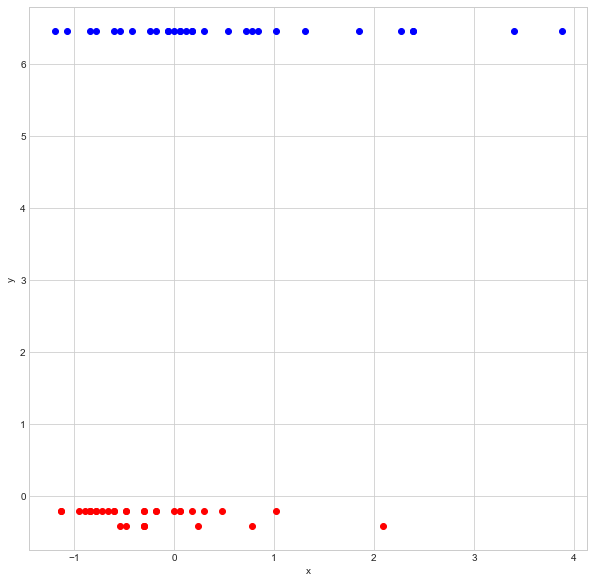

In [61]:
dbsc = hdbscan(SS,15,10)

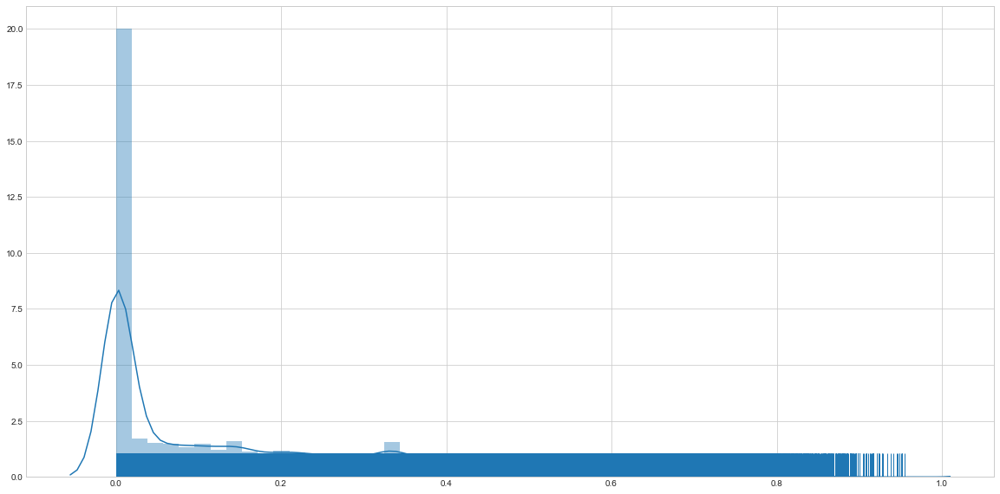

In [62]:
plt.figure(figsize=(20,10))
sns.distplot(dbsc.outlier_scores_[np.isfinite(dbsc.outlier_scores_)], rug=True)

In [64]:
np.sum(dbsc.outlier_scores_>0.9)

46

In [50]:
outliers = dbsc.outlier_scores_
FF_NR['hdbsc'] =  np.where(outliers >0.9, 1, 0)
#FF_NR['hdbsc'].fillna(0, inplace=True)

In [311]:
FF_NR.to_csv("D:\\EndProject\\FF_NR.csv", encoding='utf-8', index=False)

In [335]:
len(FF_NR.loc[(FF_NR['hdbsc'] == 1)])

2

In [ ]:
### statistics before removing outliers lines
display(pd.DataFrame(FF_NR.describe()))

In [336]:
FF_NR = FF_NR.loc[(FF_NR['hdbsc'] != 1)]

In [ ]:
### check for changes in the statistics after outliers removal
display(pd.DataFrame(FF_NR.describe()))

In [337]:
del FF_NR['hdbsc']

In [338]:
FF_NR.to_csv("D:\\EndProject\\FF_NReady.csv", encoding='utf-8', index=False)

In [339]:
len(FF_NR)

252106

## Running dbscan on reservations only flatfile model

In [298]:
V_O = ['visitors','reservations', 'daily_reservations','st_vincenty','high_temperature',
                  'low_temperature','precipitation','hours_sunlight','solar_radiation','deepest_snowfall','total_snowfall','avg_wind_speed','avg_vapor_pressure','avg_local_pressure',
                  'avg_humidity','avg_sea_pressure','cloud_cover']
print(FF_OR[V_O].isna().sum())

visitors              0
reservations          0
daily_reservations    0
st_vincenty           0
high_temperature      0
low_temperature       0
precipitation         0
hours_sunlight        0
solar_radiation       0
deepest_snowfall      0
total_snowfall        0
avg_wind_speed        0
avg_vapor_pressure    0
avg_local_pressure    0
avg_humidity          0
avg_sea_pressure      0
cloud_cover           0
dtype: int64


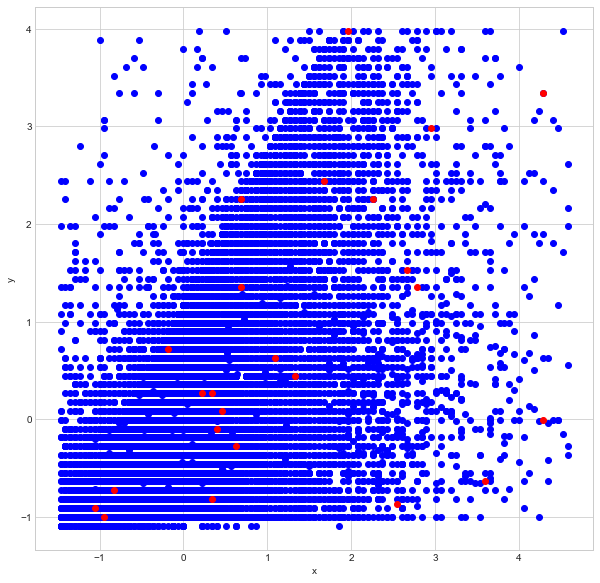

In [299]:
dbsc = dbscan_mvoutliers(FF_OR[V_O],3,10)

In [300]:
labels = dbsc.labels_
FF_OR['dbsc'] =  np.where(labels == -1, 1, 0)

In [301]:
FF_OR.to_csv("D:\\EndProject\\FF_OR.csv", encoding='utf-8', index=False)

In [302]:
len(FF_OR)

28064

In [303]:
len(FF_OR.loc[(FF_OR['dbsc'] == 1)])

24

In [304]:
FF_OR = FF_OR.loc[FF_OR['dbsc'] == 0]

In [305]:
del FF_OR['dbsc']

In [306]:
FF_OR.to_csv("D:\\EndProject\\FF_OReady.csv", encoding='utf-8', index=False)

In [307]:
len(FF_OR)

28040

### Now we have the two flatfiles with out out liers!

# Features selection.

In [15]:
# Reading ready dataframes from csv.
FF_NReady = pd.read_csv("D:\\EndProject\\FF_NReady.csv",header=0)
FF_OReady = pd.read_csv("D:\\EndProject\\FF_OReady.csv",header=0)

In [5]:
# Optional testing outliers treatment
#FF = pd.read_csv("D:\\EndProject\\FF.csv",header=0)
#FF_NReady = FF.copy()
#del FF_NReady['reservations']
#FF_OReady = FF.loc[FF['reservations'].notnull()]

In [6]:
#FF_NReady.head()

In [7]:
# Continuous
V_Con = ['daily_reservations','latitude','longitude','st_vincenty','avg_temperature','high_temperature','low_temperature','precipitation','hours_sunlight','solar_radiation','deepest_snowfall','total_snowfall','avg_wind_speed','avg_vapor_pressure','avg_local_pressure','avg_humidity','avg_sea_pressure','cloud_cover','daily_avg_visitors','daily_median_visitors','avg_visitors_day_of_week','avg_visitors_area1','avg_visitors_genre','median_visitors_day_of_week','median_visitors_area1','median_visitors_genre','avg_visitors_dow_holiday','avg_visitors_area1_holiday','avg_visitors_genre_holiday','median_visitors_dow_holiday','median_visitors_area1_holiday','median_visitors_genre_holiday','avg_visitors_dow_area1_holiday','avg_visitors_dow_area1_genre_holiday','avg_visitors_dow_area1','avg_visitors_dow_area1_genre','median_visitors_dow_area1_holiday','median_visitors_dow_area1_genre_holiday','median_visitors_dow_area1','median_visitors_dow_area1_genre','avg_visitors_per_store','median_visitors_per_store','avg_visitors_per_store_dow','median_visitors_per_store_dow']
V_Ord = ['year','month','week','day']
V_Cat = ['holiday_flg','is_rain','is_snow','Friday','Saturday','Sunday','Monday','Tuesday','Wednesday','Izakaya','Bar/Cocktail','Western food','Cafe/Sweets','Dining bar','Italian/French','Other','Japanese food','Creative cuisine','Yakiniku/Korean food','Okonomiyaki/Monja/Teppanyaki','Asian','Karaoke/Party','Tokyo','Fukuoka','Miyagi','Osaka','Hyogo','Hiroshima','Hokkaido Sapporo','Hokkaido Asahikawa','Hokkaido Abashiri','Shizuoka','Niigata','Tokyo_to Nerima','Fukuoka_ken Fukuoka','Miyagi_ken Sendai','Fukuoka_ken Kurume','Osaka_fu Neyagawa','Tokyo_to Shinjuku','Tokyo_to Shibuya','Hyogo_ken Kobe','Tokyo_to Chiyoda','Hyogo_ken Takarazuka','Hiroshima_ken Hiroshima','Tokyo_to Setagaya','Osaka_fu Osaka','Tokyo_to Bunkyo','Hiroshima_ken Fukuyama','Hokkaido Sapporo_shi Minami 3 Jonishi','Tokyo_to Suginami','Tokyo_to Minato','Tokyo_to Nakano','Tokyo_to Toshima','Tokyo_to Taito','Hokkaido Asahikawa_shi 6 Jodori','Hyogo_ken Nishinomiya','Hokkaido Abashiri_shi Minami 6 Johigashi','Shizuoka_ken Shizuoka','Fukuoka_ken Yame','Shizuoka_ken Hamamatsu','Tokyo_to Meguro','Tokyo_to Chūo','Niigata_ken Niigata','Tokyo_to Koto','Fukuoka_ken Itoshima','Fukuoka_ken Kitakyūshū','Tokyo_to Koganei','Hyogo_ken Kakogawa','Tokyo_to Itabashi','Tokyo_to Ota','Niigata_ken Nagaoka','Tokyo_to Machida','Osaka_fu Higashiosaka','Tokyo_to Shinagawa','Tokyo_to Tachikawa','Tokyo_to Katsushika','Shizuoka_ken Numazu','Hyogo_ken Himeji','Hokkaido Sapporo_shi Kotoni 2 Jo','Osaka_fu Sakai','Hokkaido Kato_gun Motomachi','Niigata_ken Kashiwazaki','Tokyo_to Kita','Tokyo_to Musashino','Tokyo_to Adachi','Hokkaido Sapporo_shi Atsubetsuchūo 1 Jo','Tokyo_to Edogawa','Osaka_fu Suita','Hokkaido Sapporo_shi Kita 24 Jonishi','Hyogo_ken Amagasaki','Thursday','International cuisine','Hokkaido Kato','Tokyo_to Fuchū']
V_Str = ['day_of_week','area1','area2','area1_2','station_id','dow','air_store_id','air_genre_name','air_area_name']
V_Date = ['visit_date']
V_y = ['visitors']

In [8]:
Vars = V_Con + V_Ord + V_Cat

In [9]:
varSel = pd.DataFrame({'Variable': Vars})

## FF_NR

In [10]:
x = FF_NReady[Vars]
y = FF_NReady[V_y]

In [11]:
# Linear models need to be standardized
names = x.columns
scaler = preprocessing.StandardScaler()
scaled_df = scaler.fit_transform(x)
scaled_df = pd.DataFrame(scaled_df, columns=names)

c:\users\rnonk\appdata\local\programs\python\python35\lib\site-packages\sklearn\preprocessing\data.py:625: DataConversionWarning: Data with input dtype int64, float64 were all converted to float64 by StandardScaler.
  return self.partial_fit(X, y)
c:\users\rnonk\appdata\local\programs\python\python35\lib\site-packages\sklearn\base.py:462: DataConversionWarning: Data with input dtype int64, float64 were all converted to float64 by StandardScaler.
  return self.fit(X, **fit_params).transform(X)


#### Variable Selection using LASSO (L1 penalization)

In [12]:
lassomod = Lasso(alpha=0.03, fit_intercept=True, normalize=False, copy_X=True).fit(scaled_df, y)

In [13]:
model = SelectFromModel(lassomod, prefit=True)

In [14]:
varSel['Lasso'] = model.get_support().astype('int64')

#### Variable Selection using Linear Regression

In [15]:
lrmod = LinearRegression(fit_intercept=True, normalize=False, copy_X=True, n_jobs=2).fit(scaled_df, y)

In [16]:
model = SelectFromModel(lrmod, prefit=True)

In [17]:
varSel['LinearRegression'] = model.get_support().astype('int64')

#### Variable Selection using Random Forest

In [18]:
rfmod = RandomForestRegressor().fit(x, y)

c:\users\rnonk\appdata\local\programs\python\python35\lib\site-packages\sklearn\ensemble\forest.py:246: FutureWarning: The default value of n_estimators will change from 10 in version 0.20 to 100 in 0.22.
  "10 in version 0.20 to 100 in 0.22.", FutureWarning)
c:\users\rnonk\appdata\local\programs\python\python35\lib\site-packages\ipykernel_launcher.py:1: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  """Entry point for launching an IPython kernel.


In [19]:
model = SelectFromModel(rfmod, prefit=True)

In [20]:
varSel['RandomForest'] = model.get_support().astype('int64')

#### Variable Selection using Gradient Boosting regressor

In [21]:
gbmod = GradientBoostingRegressor(max_features='sqrt').fit(x, y)
#loss='huber', learning_rate=0.1, n_estimators=100, criterion='friedman_mse', alpha=0.9
#'ls', 'lad', 'huber', 'quantile'

c:\users\rnonk\appdata\local\programs\python\python35\lib\site-packages\sklearn\utils\validation.py:761: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


In [22]:
model = SelectFromModel(gbmod, prefit=True)

In [23]:
varSel['GradientBoost'] = model.get_support().astype('int64')

#### Variable Selection using SVM regressor

In [24]:
svmmod = LinearSVR().fit(x, y)

c:\users\rnonk\appdata\local\programs\python\python35\lib\site-packages\sklearn\utils\validation.py:761: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
c:\users\rnonk\appdata\local\programs\python\python35\lib\site-packages\sklearn\svm\base.py:931: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  "the number of iterations.", ConvergenceWarning)


In [25]:
model = SelectFromModel(svmmod, prefit=True)

In [26]:
varSel['SVR'] = model.get_support().astype('int64')

#### Variable Selection using XGBoost regressor

In [27]:
xgbmod = XGBRegressor().fit(x, y)

In [28]:
model = SelectFromModel(xgbmod, prefit=True)

In [29]:
varSel['XGBoost'] = model.get_support().astype('int64')

#### Variable Selection using AdaBoost regressor

In [30]:
adaboost = AdaBoostRegressor(loss='square').fit(x, y)

c:\users\rnonk\appdata\local\programs\python\python35\lib\site-packages\sklearn\utils\validation.py:761: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


In [31]:
model = SelectFromModel(adaboost, prefit=True)

In [32]:
varSel['AdaBoost'] = model.get_support().astype('int64')

In [33]:
varSel['Total'] = varSel['Lasso'] + varSel['LinearRegression'] + varSel['RandomForest'] + varSel['GradientBoost'] + varSel['SVR'] + varSel['XGBoost'] + varSel['AdaBoost']
varSel

,Variable,Lasso,LinearRegression,RandomForest,GradientBoost,SVR,XGBoost,AdaBoost,Total
0,daily_reservations,1,0,1,0,0,1,1,4
1,latitude,0,0,1,0,1,0,1,3
2,longitude,0,0,1,0,0,1,1,3
3,st_vincenty,0,0,1,0,0,0,1,2
4,avg_temperature,0,0,1,0,0,0,1,2
5,high_temperature,0,0,1,0,1,0,1,3
6,low_temperature,0,0,1,0,0,0,0,1
7,precipitation,1,0,1,0,0,1,1,4
8,hours_sunlight,1,0,1,0,1,0,1,4
9,solar_radiation,1,0,1,0,0,1,1,4


In [34]:
Var_NR = varSel['Variable'].loc[varSel['Total'] >= 4]

In [64]:
Var_NR.to_csv("D:\\EndProject\\Var_NR.csv", encoding='utf-8', index=False)

In [36]:
V_Cat = ['holiday_flg','is_rain','is_snow','Friday','Saturday','Sunday','Monday','Tuesday','Wednesday','Izakaya','Bar/Cocktail','Western food','Cafe/Sweets','Dining bar','Italian/French','Other','Japanese food','Creative cuisine','Yakiniku/Korean food','Okonomiyaki/Monja/Teppanyaki','Asian','Karaoke/Party','Tokyo','Fukuoka','Miyagi','Osaka','Hyogo','Hiroshima','Hokkaido Sapporo','Hokkaido Asahikawa','Hokkaido Abashiri','Shizuoka','Niigata','Tokyo_to Nerima','Fukuoka_ken Fukuoka','Miyagi_ken Sendai','Fukuoka_ken Kurume','Osaka_fu Neyagawa','Tokyo_to Shinjuku','Tokyo_to Shibuya','Hyogo_ken Kobe','Tokyo_to Chiyoda','Hyogo_ken Takarazuka','Hiroshima_ken Hiroshima','Tokyo_to Setagaya','Osaka_fu Osaka','Tokyo_to Bunkyo','Hiroshima_ken Fukuyama','Hokkaido Sapporo_shi Minami 3 Jonishi','Tokyo_to Suginami','Tokyo_to Minato','Tokyo_to Nakano','Tokyo_to Toshima','Tokyo_to Taito','Hokkaido Asahikawa_shi 6 Jodori','Hyogo_ken Nishinomiya','Hokkaido Abashiri_shi Minami 6 Johigashi','Shizuoka_ken Shizuoka','Fukuoka_ken Yame','Shizuoka_ken Hamamatsu','Tokyo_to Meguro','Tokyo_to Chūo','Niigata_ken Niigata','Tokyo_to Koto','Fukuoka_ken Itoshima','Fukuoka_ken Kitakyūshū','Tokyo_to Koganei','Hyogo_ken Kakogawa','Tokyo_to Itabashi','Tokyo_to Ota','Niigata_ken Nagaoka','Tokyo_to Machida','Osaka_fu Higashiosaka','Tokyo_to Shinagawa','Tokyo_to Tachikawa','Tokyo_to Katsushika','Shizuoka_ken Numazu','Hyogo_ken Himeji','Hokkaido Sapporo_shi Kotoni 2 Jo','Osaka_fu Sakai','Hokkaido Kato_gun Motomachi','Niigata_ken Kashiwazaki','Tokyo_to Kita','Tokyo_to Musashino','Tokyo_to Adachi','Hokkaido Sapporo_shi Atsubetsuchūo 1 Jo','Tokyo_to Edogawa','Osaka_fu Suita','Hokkaido Sapporo_shi Kita 24 Jonishi','Hyogo_ken Amagasaki','Thursday','International cuisine']
Vars1 = V_Con + ['reservations'] + V_Ord + V_Cat

In [37]:
varSel1 = pd.DataFrame({'Variable': Vars1})

## FF_OR

In [38]:
x = FF_OReady[Vars1]
y = FF_OReady[V_y]

In [39]:
# Linear models need to be standardized
names = x.columns
scaler = preprocessing.StandardScaler()
scaled_df = scaler.fit_transform(x)
scaled_df = pd.DataFrame(scaled_df, columns=names)

c:\users\rnonk\appdata\local\programs\python\python35\lib\site-packages\sklearn\preprocessing\data.py:625: DataConversionWarning: Data with input dtype int64, float64 were all converted to float64 by StandardScaler.
  return self.partial_fit(X, y)
c:\users\rnonk\appdata\local\programs\python\python35\lib\site-packages\sklearn\base.py:462: DataConversionWarning: Data with input dtype int64, float64 were all converted to float64 by StandardScaler.
  return self.fit(X, **fit_params).transform(X)


#### Variable Selection using LASSO (L1 penalization)

In [40]:
lassomod = Lasso(alpha=0.03, fit_intercept=True, normalize=False, copy_X=True).fit(scaled_df, y)

In [41]:
model = SelectFromModel(lassomod, prefit=True)

In [42]:
varSel1['Lasso'] = model.get_support().astype('int64')

#### Variable Selection using Linear Regression

In [43]:
lrmod = LinearRegression(fit_intercept=True, normalize=False, copy_X=True, n_jobs=2).fit(scaled_df, y)

In [44]:
model = SelectFromModel(lrmod, prefit=True)

In [45]:
varSel1['LinearRegression'] = model.get_support().astype('int64')

#### Variable Selection using Random Forest

In [46]:
rfmod = RandomForestRegressor().fit(x, y)

c:\users\rnonk\appdata\local\programs\python\python35\lib\site-packages\sklearn\ensemble\forest.py:246: FutureWarning: The default value of n_estimators will change from 10 in version 0.20 to 100 in 0.22.
  "10 in version 0.20 to 100 in 0.22.", FutureWarning)
c:\users\rnonk\appdata\local\programs\python\python35\lib\site-packages\ipykernel_launcher.py:1: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  """Entry point for launching an IPython kernel.


In [47]:
model = SelectFromModel(rfmod, prefit=True)

In [48]:
varSel1['RandomForest'] = model.get_support().astype('int64')

#### Variable Selection using Gradient Boosting regressor

In [49]:
gbmod = GradientBoostingRegressor(max_features='sqrt').fit(x, y)
#loss='huber', learning_rate=0.1, n_estimators=100, criterion='friedman_mse', alpha=0.9
#'ls', 'lad', 'huber', 'quantile'

c:\users\rnonk\appdata\local\programs\python\python35\lib\site-packages\sklearn\utils\validation.py:761: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


In [50]:
model = SelectFromModel(gbmod, prefit=True)

In [51]:
varSel1['GradientBoost'] = model.get_support().astype('int64')

#### Variable Selection using SVM regressor

In [52]:
svmmod = LinearSVR().fit(x, y)

c:\users\rnonk\appdata\local\programs\python\python35\lib\site-packages\sklearn\utils\validation.py:761: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
c:\users\rnonk\appdata\local\programs\python\python35\lib\site-packages\sklearn\svm\base.py:931: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  "the number of iterations.", ConvergenceWarning)


In [53]:
model = SelectFromModel(svmmod, prefit=True)

In [54]:
varSel1['SVR'] = model.get_support().astype('int64')

#### Variable Selection using XGBoost regressor

In [55]:
xgbmod = XGBRegressor().fit(x, y)

In [56]:
model = SelectFromModel(xgbmod, prefit=True)

In [57]:
varSel1['XGBoost'] = model.get_support().astype('int64')

#### Variable Selection using AdaBoost regressor

In [58]:
adaboost = AdaBoostRegressor(loss='square').fit(x, y)

c:\users\rnonk\appdata\local\programs\python\python35\lib\site-packages\sklearn\utils\validation.py:761: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


In [59]:
model = SelectFromModel(adaboost, prefit=True)

In [60]:
varSel1['AdaBoost'] = model.get_support().astype('int64')

In [61]:
varSel1['Total'] = varSel1['Lasso'] + varSel1['LinearRegression'] + varSel1['RandomForest'] + varSel1['GradientBoost'] + varSel1['SVR'] + varSel1['XGBoost'] + varSel1['AdaBoost']
varSel1

,Variable,Lasso,LinearRegression,RandomForest,GradientBoost,SVR,XGBoost,AdaBoost,Total
0,daily_reservations,1,0,1,1,0,1,1,5
1,latitude,0,0,0,0,1,1,1,3
2,longitude,0,0,0,0,1,1,0,2
3,st_vincenty,0,0,1,0,1,1,1,4
4,avg_temperature,0,0,0,0,0,0,0,0
5,high_temperature,0,0,1,0,1,1,1,4
6,low_temperature,1,0,1,0,1,1,1,5
7,precipitation,0,0,1,0,0,0,1,2
8,hours_sunlight,1,0,1,0,1,0,1,4
9,solar_radiation,1,0,1,0,1,1,1,5


In [62]:
Var_OR = varSel1['Variable'].loc[varSel1['Total'] >= 4]

In [65]:
Var_OR.to_csv("D:\\EndProject\\Var_OR.csv", encoding='utf-8', index=False)

# Train Dev Test Split

In [66]:
from random import seed, shuffle
from importlib import reload
#from pyTable1 import pyTABLE1
import pyTable1 as tb1
#if is_changed(pyTable1):
reload(tb1)

<module 'pyTable1' from 'D:\\EndProject\\pyTable1.py'>

In [67]:
FF_OReady = FF_OReady.loc[FF_OReady['visit_date'] < '2017-04-01']
FF_NReady = FF_NReady.loc[FF_NReady['visit_date'] < '2017-04-01']

In [68]:
V_OR = list(Var_OR) + ['visitors'] #['air_store_id', 'visit_date']
V_NR = list(Var_NR) + ['visitors'] #['air_store_id', 'visit_date']

FFO = FF_OReady[V_OR]
FFN = FF_NReady[V_NR]

In [69]:
seed(101)
Oind = [i for i in range(len(FFO))]
print(Oind[0:15])
shuffle(Oind,)
print(Oind[0:15])

Osplit_1 = int(0.1 * len(Oind))
### train-dev split
Osplit_2 = int(0.3 * len(Oind))

FFO['dataset'] = "train"
FFO.iloc[Oind[0:Osplit_1],len(FFO.columns)-1] = "test"
FFO.iloc[Oind[Osplit_1:Osplit_2],len(FFO.columns)-1] = "dev"
FFO['dataset'] = FFO['dataset'].astype('category')

Ovn = FFO.columns.tolist()
O_tab1 = tb1.pyTABLE1(x=Ovn,y="dataset",data=FFO,categorize=True,maxcat=7).getTable1()

[0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14]
[10829, 17043, 4622, 13306, 23771, 12204, 25090, 8126, 6232, 22576, 13209, 7181, 20750, 11286, 15391]
Factorizing... please wait
[******************
[]
*******************
*******************
*******************
[]
------ Finished in 8.960921049118042econds -----


In [70]:
O_tab1.loc[(O_tab1['p_value']<0.05),]

,Variables,Categories,Population,Category_dev,Category_train,Category_test,p_value


In [71]:
seed(102)
Nind = [i for i in range(len(FFN))]
print(Nind[0:15])
shuffle(Nind,)
print(Nind[0:15])

Nsplit_1 = int(0.1 * len(Nind))
### train-dev split
Nsplit_2 = int(0.3 * len(Nind))

FFN['dataset'] = "train"
FFN.iloc[Nind[0:Nsplit_1],len(FFN.columns)-1] = "test"
FFN.iloc[Nind[Nsplit_1:Nsplit_2],len(FFN.columns)-1] = "dev"
FFN['dataset'] = FFN['dataset'].astype('category')

Nvn = FFN.columns.tolist()
N_tab1 = tb1.pyTABLE1(x=Nvn,y="dataset",data=FFN,categorize=True,maxcat=7).getTable1()

[0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14]
[147504, 68938, 109889, 47454, 71129, 171278, 153075, 218783, 47653, 76271, 90499, 33198, 87020, 27203, 176271]
Factorizing... please wait
[****************
[]
*****************
*****************
*****************
[]
------ Finished in 10.649909019470215econds -----


In [72]:
N_tab1.loc[(N_tab1['p_value']<0.05),]

,Variables,Categories,Population,Category_train,Category_dev,Category_test,p_value


In [73]:
### We will split as follows: 10% test, 20% dev and 70% train
OX_train = FFO.loc[FFO['dataset'] == "train"]
Oy_train = OX_train['visitors']
del OX_train['visitors']
del OX_train['dataset']
OX_dev = FFO.loc[FFO['dataset'] == "dev"]
Oy_dev = OX_dev['visitors']
del OX_dev['visitors']
del OX_dev['dataset']
OX_test = FFO.loc[FFO['dataset'] == "test"]
Oy_test = OX_test['visitors']
del OX_test['visitors']
del OX_test['dataset']


NX_train = FFN.loc[FFN['dataset'] == "train"]
Ny_train = NX_train['visitors']
del NX_train['visitors']
del NX_train['dataset']
NX_dev = FFN.loc[FFN['dataset'] == "dev"]
Ny_dev = NX_dev['visitors']
del NX_dev['visitors']
del NX_dev['dataset']
NX_test = FFN.loc[FFN['dataset'] == "test"]
Ny_test = NX_test['visitors']
del NX_test['visitors']
del NX_test['dataset']

In [74]:
print(OX_train.shape)
print(Oy_train.shape)
print(OX_dev.shape)
print(Oy_dev.shape)
print(OX_test.shape)
print(Oy_test.shape)

print(NX_train.shape)
print(Ny_train.shape)
print(NX_dev.shape)
print(Ny_dev.shape)
print(NX_test.shape)
print(Ny_test.shape)

(17651, 17)
(17651,)
(5043, 17)
(5043,)
(2521, 17)
(2521,)
(165436, 15)
(165436,)
(47267, 15)
(47267,)
(23633, 15)
(23633,)


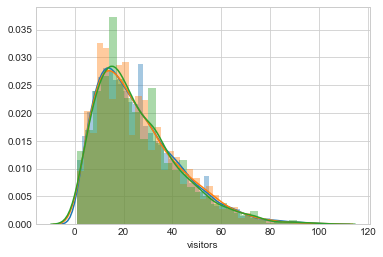

In [75]:
sns.distplot(Oy_train,label="train")
sns.distplot(Oy_dev,label="dev")
sns.distplot(Oy_test,label="test")

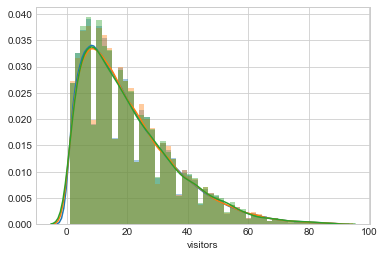

In [76]:
sns.distplot(Ny_train,label="train")
sns.distplot(Ny_dev,label="dev")
sns.distplot(Ny_test,label="test")

In [77]:
OX_train.to_csv("D:\\EndProject\\OX_train.csv", encoding='utf-8', header=1, index=False)
Oy_train.to_csv("D:\\EndProject\\Oy_train.csv", encoding='utf-8', header=1, index=False)
OX_dev.to_csv("D:\\EndProject\\OX_dev.csv", encoding='utf-8', header=1, index=False)
Oy_dev.to_csv("D:\\EndProject\\Oy_dev.csv", encoding='utf-8', header=1, index=False)
OX_test.to_csv("D:\\EndProject\\OX_test.csv", encoding='utf-8', header=1, index=False)
Oy_test.to_csv("D:\\EndProject\\Oy_test.csv", encoding='utf-8', header=1, index=False)

NX_train.to_csv("D:\\EndProject\\NX_train.csv", encoding='utf-8', header=1, index=False)
Ny_train.to_csv("D:\\EndProject\\Ny_train.csv", encoding='utf-8', header=1, index=False)
NX_dev.to_csv("D:\\EndProject\\NX_dev.csv", encoding='utf-8', header=1, index=False)
Ny_dev.to_csv("D:\\EndProject\\Ny_dev.csv", encoding='utf-8', header=1, index=False)
NX_test.to_csv("D:\\EndProject\\NX_test.csv", encoding='utf-8', header=1, index=False)
Ny_test.to_csv("D:\\EndProject\\Ny_test.csv", encoding='utf-8', header=1, index=False)

In [5]:
OX_train = pd.read_csv("D:\\EndProject\\OX_train.csv",header=0)
Oy_train = pd.read_csv("D:\\EndProject\\Oy_train.csv",header=0)
OX_dev = pd.read_csv("D:\\EndProject\\OX_dev.csv",header=0)
Oy_dev = pd.read_csv("D:\\EndProject\\Oy_dev.csv",header=0)
OX_test = pd.read_csv("D:\\EndProject\\OX_test.csv",header=0)
Oy_test = pd.read_csv("D:\\EndProject\\Oy_test.csv",header=0)

NX_train = pd.read_csv("D:\\EndProject\\NX_train.csv",header=0)
Ny_train = pd.read_csv("D:\\EndProject\\Ny_train.csv",header=0)
NX_dev = pd.read_csv("D:\\EndProject\\NX_dev.csv",header=0)
Ny_dev = pd.read_csv("D:\\EndProject\\Ny_dev.csv",header=0)
NX_test = pd.read_csv("D:\\EndProject\\NX_test.csv",header=0)
Ny_test = pd.read_csv("D:\\EndProject\\Ny_test.csv",header=0)

In [6]:
Oy_train = Oy_train['visitors']
Oy_dev = Oy_dev['visitors']
Oy_test = Oy_test['visitors']

Ny_train = Ny_train['visitors']
Ny_dev = Ny_dev['visitors']
Ny_test = Ny_test['visitors']

In [7]:
print(OX_train.shape)
print(Oy_train.shape)
print(OX_dev.shape)
print(Oy_dev.shape)
print(OX_test.shape)
print(Oy_test.shape)

print(NX_train.shape)
print(Ny_train.shape)
print(NX_dev.shape)
print(Ny_dev.shape)
print(NX_test.shape)
print(Ny_test.shape)

(17651, 17)
(17651,)
(5043, 17)
(5043,)
(2521, 17)
(2521,)
(165436, 15)
(165436,)
(47267, 15)
(47267,)
(23633, 15)
(23633,)


# Predictive Models

### ElasticNet - L1/L2 regularization

In [457]:
# ElasticNet
from sklearn.linear_model import ElasticNet
from sklearn.metrics import r2_score

enet = ElasticNet(alpha=0.1, l1_ratio=0.6)

Oy_pred_enet = enet.fit(OX_train, Oy_train).predict(OX_test)
r2_score_enet = r2_score(Oy_test, Oy_pred_enet)
print(enet)
print("r^2 on test data : %f" % r2_score_enet)

ElasticNet(alpha=0.1, copy_X=True, fit_intercept=True, l1_ratio=0.6,
      max_iter=1000, normalize=False, positive=False, precompute=False,
      random_state=None, selection='cyclic', tol=0.0001, warm_start=False)
r^2 on test data : 0.658480


In [12]:
from sklearn.linear_model import ElasticNet

alphas = [0.001, 0.01, 0.1, 0.5, 1, 10]
l1_ratios = [0.4, 0.5, 0.6, 0.7, 0.8]
print('All errors are RMSLE')
print('-'*76)
for ratio in l1_ratios:
    for alpha in alphas:
        # instantiate and fit model
        elast = ElasticNet(alpha=alpha, l1_ratio=ratio, random_state=53)
        elast.fit(OX_train, Oy_train)
        # calculate errors
        new_train_error = rmsle(list(Oy_train), elast.predict(OX_train))
        new_validation_error =rmsle(list(Oy_dev), elast.predict(OX_dev))
        new_test_error = rmsle(list(Oy_test), elast.predict(OX_test))
        # print errors as report
        print('alpha: {:7} | l1_ratio: {:6} | train error: {:5} | val error: {:6} | test error: {}'. format(alpha, ratio, round(new_train_error,3), round(new_validation_error,3), round(new_test_error,3)))

All errors are RMSLE
----------------------------------------------------------------------------
alpha:   0.001 | l1_ratio:    0.4 | train error: 0.432 | val error:   0.43 | test error: 0.422
alpha:    0.01 | l1_ratio:    0.4 | train error: 0.432 | val error:   0.43 | test error: 0.422
alpha:     0.1 | l1_ratio:    0.4 | train error: 0.431 | val error:   0.43 | test error: 0.421
alpha:     0.5 | l1_ratio:    0.4 | train error: 0.431 | val error:   0.43 | test error: 0.42
alpha:       1 | l1_ratio:    0.4 | train error: 0.431 | val error:   0.43 | test error: 0.42
alpha:      10 | l1_ratio:    0.4 | train error: 0.443 | val error:  0.443 | test error: 0.435
alpha:   0.001 | l1_ratio:    0.5 | train error: 0.432 | val error:   0.43 | test error: 0.422
alpha:    0.01 | l1_ratio:    0.5 | train error: 0.432 | val error:   0.43 | test error: 0.422
alpha:     0.1 | l1_ratio:    0.5 | train error: 0.431 | val error:   0.43 | test error: 0.421
alpha:     0.5 | l1_ratio:    0.5 | train error: 

In [44]:
elast = ElasticNet(alpha=0.5, l1_ratio=0.7, random_state=53)
elast.fit(OX_train, Oy_train)
new_train_error = rmsle(list(Oy_train), elast.predict(OX_train))
new_validation_error =rmsle(list(Oy_dev), elast.predict(OX_dev))
new_test_error = rmsle(list(Oy_test), elast.predict(OX_test))
# print errors as report
print('alpha: 0.5 | l1_ratio: 0.7 | train error: ' + format(round(new_train_error,3)) + ' | val error: ' + format(round(new_validation_error,3)) + ' | test error: ' +  format(round(new_test_error,3)))

alpha: 0.5 | l1_ratio: 0.7 | train error: 0.431 | val error: 0.43 | test error: 0.42


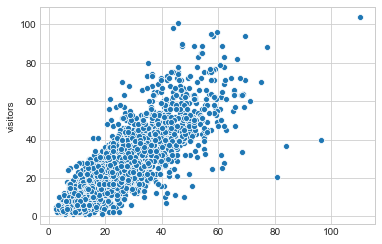

In [36]:
Oy_hat = elast.predict(OX_test)
sns.scatterplot(Oy_hat, Oy_test)

In [28]:
from sklearn.linear_model import ElasticNet

alphas = [0.1, 0.5, 1, 5, 10]
l1_ratios = [0.5, 0.6, 0.7, 0.8]
print('All errors are RMSLE')
print('-'*76)
for ratio in l1_ratios:
    for alpha in alphas:
        # instantiate and fit model
        elast = ElasticNet(alpha=alpha, l1_ratio=ratio, random_state=53)
        elast.fit(NX_train, Ny_train)
        # calculate errors
        new_train_error = rmsle1(list(Ny_train), elast.predict(NX_train))
        new_validation_error =rmsle1(list(Ny_dev), elast.predict(NX_dev))
        new_test_error = rmsle1(list(Ny_test), elast.predict(NX_test))
        # print errors as report
        print('alpha: {:7} | l1_ratio: {:6} | train error: {:5} | val error: {:6} | test error: {}'. format(alpha, ratio, round(new_train_error,3), round(new_validation_error,3), round(new_test_error,3)))

All errors are RMSLE
----------------------------------------------------------------------------


c:\users\rnonk\appdata\local\programs\python\python35\lib\site-packages\ipykernel_launcher.py:13: RuntimeWarning: invalid value encountered in log
  del sys.path[0]
c:\users\rnonk\appdata\local\programs\python\python35\lib\site-packages\ipykernel_launcher.py:13: RuntimeWarning: invalid value encountered in log
  del sys.path[0]


alpha:     0.1 | l1_ratio:    0.5 | train error:   nan | val error:    nan | test error: 0.537


c:\users\rnonk\appdata\local\programs\python\python35\lib\site-packages\ipykernel_launcher.py:13: RuntimeWarning: invalid value encountered in log
  del sys.path[0]


alpha:     0.5 | l1_ratio:    0.5 | train error:   nan | val error:  0.534 | test error: 0.536


c:\users\rnonk\appdata\local\programs\python\python35\lib\site-packages\ipykernel_launcher.py:13: RuntimeWarning: invalid value encountered in log
  del sys.path[0]


alpha:       1 | l1_ratio:    0.5 | train error:   nan | val error:  0.535 | test error: 0.536
alpha:       5 | l1_ratio:    0.5 | train error: 0.543 | val error:  0.544 | test error: 0.544
alpha:      10 | l1_ratio:    0.5 | train error: 0.549 | val error:   0.55 | test error: 0.551


c:\users\rnonk\appdata\local\programs\python\python35\lib\site-packages\ipykernel_launcher.py:13: RuntimeWarning: invalid value encountered in log
  del sys.path[0]
c:\users\rnonk\appdata\local\programs\python\python35\lib\site-packages\ipykernel_launcher.py:13: RuntimeWarning: invalid value encountered in log
  del sys.path[0]


alpha:     0.1 | l1_ratio:    0.6 | train error:   nan | val error:    nan | test error: 0.537


c:\users\rnonk\appdata\local\programs\python\python35\lib\site-packages\ipykernel_launcher.py:13: RuntimeWarning: invalid value encountered in log
  del sys.path[0]


alpha:     0.5 | l1_ratio:    0.6 | train error:   nan | val error:  0.534 | test error: 0.536


c:\users\rnonk\appdata\local\programs\python\python35\lib\site-packages\ipykernel_launcher.py:13: RuntimeWarning: invalid value encountered in log
  del sys.path[0]


alpha:       1 | l1_ratio:    0.6 | train error:   nan | val error:  0.535 | test error: 0.537
alpha:       5 | l1_ratio:    0.6 | train error: 0.544 | val error:  0.545 | test error: 0.546
alpha:      10 | l1_ratio:    0.6 | train error:  0.55 | val error:  0.551 | test error: 0.552


c:\users\rnonk\appdata\local\programs\python\python35\lib\site-packages\ipykernel_launcher.py:13: RuntimeWarning: invalid value encountered in log
  del sys.path[0]
c:\users\rnonk\appdata\local\programs\python\python35\lib\site-packages\ipykernel_launcher.py:13: RuntimeWarning: invalid value encountered in log
  del sys.path[0]


alpha:     0.1 | l1_ratio:    0.7 | train error:   nan | val error:    nan | test error: 0.537


c:\users\rnonk\appdata\local\programs\python\python35\lib\site-packages\ipykernel_launcher.py:13: RuntimeWarning: invalid value encountered in log
  del sys.path[0]


alpha:     0.5 | l1_ratio:    0.7 | train error:   nan | val error:  0.534 | test error: 0.536
alpha:       1 | l1_ratio:    0.7 | train error: 0.535 | val error:  0.535 | test error: 0.537
alpha:       5 | l1_ratio:    0.7 | train error: 0.545 | val error:  0.546 | test error: 0.547
alpha:      10 | l1_ratio:    0.7 | train error: 0.551 | val error:  0.552 | test error: 0.553


c:\users\rnonk\appdata\local\programs\python\python35\lib\site-packages\ipykernel_launcher.py:13: RuntimeWarning: invalid value encountered in log
  del sys.path[0]
c:\users\rnonk\appdata\local\programs\python\python35\lib\site-packages\ipykernel_launcher.py:13: RuntimeWarning: invalid value encountered in log
  del sys.path[0]


alpha:     0.1 | l1_ratio:    0.8 | train error:   nan | val error:    nan | test error: 0.536


c:\users\rnonk\appdata\local\programs\python\python35\lib\site-packages\ipykernel_launcher.py:13: RuntimeWarning: invalid value encountered in log
  del sys.path[0]


alpha:     0.5 | l1_ratio:    0.8 | train error:   nan | val error:  0.534 | test error: 0.536
alpha:       1 | l1_ratio:    0.8 | train error: 0.535 | val error:  0.536 | test error: 0.537
alpha:       5 | l1_ratio:    0.8 | train error: 0.546 | val error:  0.547 | test error: 0.547
alpha:      10 | l1_ratio:    0.8 | train error: 0.552 | val error:  0.553 | test error: 0.554


In [45]:
elast = ElasticNet(alpha=0.5, l1_ratio=0.7, random_state=53)
elast.fit(NX_train, Ny_train)
new_train_error = rmsle1(list(Ny_train), elast.predict(NX_train))
new_validation_error =rmsle1(list(Ny_dev), elast.predict(NX_dev))
new_test_error = rmsle1(list(Ny_test), elast.predict(NX_test))
# print errors as report
print('alpha: 0.5 | l1_ratio: 0.7 | train error: ' + format(round(new_train_error,3)) + ' | val error: ' + format(round(new_validation_error,3)) + ' | test error: ' +  format(round(new_test_error,3)))

c:\users\rnonk\appdata\local\programs\python\python35\lib\site-packages\ipykernel_launcher.py:13: RuntimeWarning: invalid value encountered in log
  del sys.path[0]


alpha: 0.5 | l1_ratio: 0.7 | train error: nan | val error: 0.534 | test error: 0.536


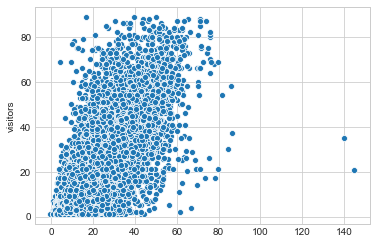

In [46]:
Ny_hat = elast.predict(NX_test)
sns.scatterplot(Ny_hat, Ny_test)

## SVM Regressor

### Fit regression model

In [97]:
# rbf kernel
svr_rbf = SVR(kernel='rbf', C=100, gamma=0.1, epsilon=.1)
svr_rbf.fit(OX_train, Oy_train)
y_rbf = svr_rbf.predict(OX_train)
y1_rbf = svr_rbf.predict(OX_dev)
y2_rbf = svr_rbf.predict(OX_test)

print(rmsle(list(Oy_train), list(y_rbf)))
print(rmsle(list(Oy_dev), list(y1_rbf)))
print(rmsle(list(Oy_test), list(y2_rbf)))

0.008147626485853087
0.7185925779896745
0.7142775241792452


In [106]:
# linear kernel
svr_lin = SVR(kernel='linear', C=100, gamma='auto')
svr_lin.fit(OX_train, Oy_train)
y_lin = svr_lin.predict(OX_train)
y1_lin = svr_lin.predict(OX_dev)
y2_lin = svr_lin.predict(OX_test)

In [ ]:
print(rmsle(list(Oy_train), list(y_lin)))
print(rmsle(list(Oy_dev), list(y1_lin)))
print(rmsle(list(Oy_test), list(y2_lin)))

SVR Linear kernel gave very bad prediction numbers,
I got an error on the rmsle calculation but, i have looked at the numbers and it gave predictions of -14,000 when the real value was 30.

In [ ]:
# polynomial kernel
svr_poly = SVR(kernel='poly', C=100, gamma='auto', degree=3, epsilon=.1, coef0=1)
svr_poly.fit(OX_train, Oy_train)
y_poly = svr_poly.predict(OX_train)
y1_poly = svr_poly.predict(OX_dev)
y2_poly = svr_poly.predict(OX_test)

In [ ]:
print(rmsle(list(Oy_train), list(y_poly)))
print(rmsle(list(Oy_dev), list(y1_poly)))
print(rmsle(list(Oy_test), list(y2_poly)))

In [78]:
SVR polynomial kernel would not stop running, run for 7 hours, then i stoped it.

#### Choose to go with rbf kernel<br/>Now i will tune the hyperparameters


In [50]:
for C in [0.01, 0.1, 1, 10]:
    for g in [0.001, 0.01, 0.1, 1]:
        svr_rbf = SVR(kernel='rbf', C=C, gamma=g, epsilon=.1)
        svr_rbf.fit(OX_train, Oy_train)
        y_rbf = svr_rbf.predict(OX_train)
        y1_rbf = svr_rbf.predict(OX_dev)
        y2_rbf = svr_rbf.predict(OX_test)
        print('C: ' + str(C) + ' | gamma: ' + str(g))
        print('train rmsle: ' + format(rmsle(list(Oy_train), list(y_rbf))))
        print('dev rmsle: ' + format(rmsle(list(Oy_dev), list(y1_rbf))))
        print('test rmsle: ' + format(rmsle(list(Oy_test), list(y2_rbf))))


C: 0.01 | gamma: 0.001
train rmsle: 0.7029796904467135
dev rmsle: 0.7043364275054621
test rmsle: 0.69838682447447
C: 0.01 | gamma: 0.01
train rmsle: 0.7063096768772664
dev rmsle: 0.7076934454510982
test rmsle: 0.7018816249639284
C: 0.01 | gamma: 0.1
train rmsle: 0.7067513453094231
dev rmsle: 0.7081360224321251
test rmsle: 0.7023564153844721
C: 0.01 | gamma: 1
train rmsle: 0.7067682046262507
dev rmsle: 0.7081516604049832
test rmsle: 0.702373482806766
C: 0.1 | gamma: 0.001
train rmsle: 0.6723979626212865
dev rmsle: 0.6766596640165377
test rmsle: 0.6696869307356313
C: 0.1 | gamma: 0.01
train rmsle: 0.6988134381632302
dev rmsle: 0.7031946622891939
test rmsle: 0.697035573988666
C: 0.1 | gamma: 0.1
train rmsle: 0.7031929628531489
dev rmsle: 0.7075726297317512
test rmsle: 0.7017239525479138
C: 0.1 | gamma: 1
train rmsle: 0.7033635073914836
dev rmsle: 0.7077303674661133
test rmsle: 0.7018960668861882
C: 1 | gamma: 0.001
train rmsle: 0.5341299050388659
dev rmsle: 0.5591123985377675
test rmsle: 

In [51]:
for C in [1, 5, 10]:
    for g in [0.0001, 0.001]:
        svr_rbf = SVR(kernel='rbf', C=C, gamma=g, epsilon=.1)
        svr_rbf.fit(OX_train, Oy_train)
        y_rbf = svr_rbf.predict(OX_train)
        y1_rbf = svr_rbf.predict(OX_dev)
        y2_rbf = svr_rbf.predict(OX_test)
        print('C: ' + str(C) + ' | gamma: ' + str(g))
        print('train rmsle: ' + format(rmsle(list(Oy_train), list(y_rbf))))
        print('dev rmsle: ' + format(rmsle(list(Oy_dev), list(y1_rbf))))
        print('test rmsle: ' + format(rmsle(list(Oy_test), list(y2_rbf))))

C: 1 | gamma: 0.0001
train rmsle: 0.5433816933494092
dev rmsle: 0.5559622106001538
test rmsle: 0.5456835500793223
C: 1 | gamma: 0.001
train rmsle: 0.5341299050388659
dev rmsle: 0.5591123985377675
test rmsle: 0.5496877692880299
C: 5 | gamma: 0.0001
train rmsle: 0.44053358224279776
dev rmsle: 0.46136158968841967
test rmsle: 0.45348533840355487
C: 5 | gamma: 0.001
train rmsle: 0.4176923097415444
dev rmsle: 0.47960544176450853
test rmsle: 0.47150402251235496
C: 10 | gamma: 0.0001
train rmsle: 0.4149210952740007
dev rmsle: 0.441628861064713
test rmsle: 0.43423852988734385
C: 10 | gamma: 0.001
train rmsle: 0.37577761646200747
dev rmsle: 0.4655809442491848
test rmsle: 0.4557335715964478


In [53]:
for C in [5, 10]:
    for g in [0.0001, 0.001]:
        for e in [1, 0.1, 0.01]:
            svr_rbf = SVR(kernel='rbf', C=C, gamma=g, epsilon=e)
            svr_rbf.fit(OX_train, Oy_train)
            y_rbf = svr_rbf.predict(OX_train)
            y1_rbf = svr_rbf.predict(OX_dev)
            y2_rbf = svr_rbf.predict(OX_test)
            print('C: ' + str(C) + ' | gamma: ' + str(g) + ' | epsilon: ' + str(e))
            print('train rmsle: ' + format(rmsle(list(Oy_train), list(y_rbf))))
            print('dev rmsle: ' + format(rmsle(list(Oy_dev), list(y1_rbf))))
            print('test rmsle: ' + format(rmsle(list(Oy_test), list(y2_rbf))))

C: 5 | gamma: 0.0001 | epsilon: 1
train rmsle: 0.4399870613424531
dev rmsle: 0.46073686906796163
test rmsle: 0.45267498944594187
C: 5 | gamma: 0.0001 | epsilon: 0.1
train rmsle: 0.44053358224279776
dev rmsle: 0.46136158968841967
test rmsle: 0.45348533840355487
C: 5 | gamma: 0.0001 | epsilon: 0.01
train rmsle: 0.4404983564500145
dev rmsle: 0.4611040225992884
test rmsle: 0.45337666962055934
C: 5 | gamma: 0.001 | epsilon: 1
train rmsle: 0.41816859301603293
dev rmsle: 0.47970752140629386
test rmsle: 0.473161941720829
C: 5 | gamma: 0.001 | epsilon: 0.1
train rmsle: 0.4176923097415444
dev rmsle: 0.47960544176450853
test rmsle: 0.47150402251235496
C: 5 | gamma: 0.001 | epsilon: 0.01
train rmsle: 0.41769861281977
dev rmsle: 0.4797049936113986
test rmsle: 0.4715123167994477
C: 10 | gamma: 0.0001 | epsilon: 1
train rmsle: 0.4143637589791303
dev rmsle: 0.4406904967457932
test rmsle: 0.43293644885592125
C: 10 | gamma: 0.0001 | epsilon: 0.1
train rmsle: 0.4149210952740007
dev rmsle: 0.4416288610647

FF_OR
C: 10 | gamma: 0.0001 | epsilon: 1
train rmsle: 0.4143637589791303
dev rmsle: 0.4406904967457932
test rmsle: 0.43293644885592125

In [8]:
#for C in [10]:
#    for g in [0.0001, 0.001]:
#        for e in [1, 0.1]:
svr_rbf = SVR(kernel='rbf', C=10, gamma=0.0001, epsilon=1)
svr_rbf.fit(NX_train, Ny_train)
#y_rbf = svr_rbf.predict(NX_train)
y1_rbf = svr_rbf.predict(NX_dev)
y2_rbf = svr_rbf.predict(NX_test)
#print('C: ' + str(C) + ' | gamma: ' + str(g) + ' | epsilon: ' + str(e))
#print('train rmsle: ' + format(rmsle(list(Ny_train), list(y_rbf))))
print('dev rmsle: ' + format(rmsle(list(Ny_dev), list(y1_rbf))))
print('test rmsle: ' + format(rmsle(list(Ny_test), list(y2_rbf))))

dev rmsle: 0.5156246799296594
test rmsle: 0.5172095464203291


## Getting ready to make the real prediction

In [93]:
Var_OR = ['daily_reservations','st_vincenty','high_temperature','low_temperature','hours_sunlight','solar_radiation','avg_local_pressure','daily_avg_visitors','avg_visitors_dow_area1_genre','median_visitors_dow_area1_genre_holiday','avg_visitors_per_store','median_visitors_per_store','avg_visitors_per_store_dow','median_visitors_per_store_dow','reservations','week','day']
Var_NR = ['daily_reservations','precipitation','hours_sunlight','solar_radiation','avg_wind_speed','daily_avg_visitors','daily_median_visitors','avg_visitors_day_of_week','avg_visitors_dow_holiday','avg_visitors_dow_area1_genre_holiday','avg_visitors_per_store','median_visitors_per_store','avg_visitors_per_store_dow','median_visitors_per_store_dow','day']

In [94]:
finaltest = pd.read_csv("D:\\EndProject\\finaltest.csv",header=0)

In [95]:
finaltest.isnull().sum()

air_store_id                                    0
air_genre_name                                  0
air_area_name                                   0
latitude                                        0
longitude                                       0
visit_date                                      0
visitors                                        0
reservations                                12941
daily_reservations                              0
dow                                             0
holiday_flg                                     0
station_id                                      0
st_lat                                          0
st_long                                         0
st_vincenty                                     0
location                                        0
avg_temperature                                 0
high_temperature                                0
low_temperature                                 0
precipitation                                   0


In [96]:
N_fintest = finaltest.loc[finaltest['reservations'].isnull()]
O_fintest = finaltest.loc[np.logical_not(finaltest['reservations'].isnull())]

In [97]:
print(O_fintest.isnull().sum().sum())
print(N_fintest.isnull().sum().sum())

0
12941


In [98]:
XO_fintest = O_fintest[Var_OR]
yO_fintest = O_fintest['visitors']

XN_fintest = N_fintest[Var_NR]
yN_fintest = N_fintest['visitors']

In [99]:
print(XO_fintest.isnull().sum().sum())
print(XN_fintest.isnull().sum().sum())

0
0


### Reservations Only model
C: 10 | gamma: 0.0001 | epsilon: 1

In [100]:
svr_rbf = SVR(kernel='rbf', C=10, gamma=0.0001, epsilon=1)
svr_rbf.fit(OX_train, Oy_train)
y_O = svr_rbf.predict(XO_fintest)

In [101]:
XO_fintest['Y'] =  y_O

In [102]:
print('rmsle: ' + format(rmsle(list(O_fintest['visitors']), list(y_O))))

rmsle: 0.5970925997098774


### No Reservations model
C: 10 | gamma: 0.0001 | epsilon: 1

In [103]:
svr_rbf = SVR(kernel='rbf', C=10, gamma=0.0001, epsilon=1)
svr_rbf.fit(NX_train, Ny_train)
y_N = svr_rbf.predict(XN_fintest)

In [106]:
XN_fintest['Y'] =  y_N

In [107]:
print('rmsle: ' + format(rmsle(list(N_fintest['visitors']), list(y_N))))

rmsle: 0.7079349229764879


### Combined

In [77]:
fin = pd.merge(XN_fintest[['Y']] , XO_fintest[['Y']],  how='outer', left_index=True, right_index=True)

In [78]:
fin['Y_Pred'] = np.round(pd.concat([XN_fintest['Y'] , XO_fintest['Y']]),0)

In [79]:
del fin['Y_x']
del fin['Y_y']

In [87]:
print('rmsle: ' + format(rmsle(list(finaltest['visitors']), list(fin['Y_Pred']))))

rmsle: 0.6904369971218494
